## Compile YOLOv4 model

In [ ]:
# Clone social_distance project
!git clone https://github.com/Andresmps/Simulation_project

In [ ]:
# Clone darknet
!git clone https://github.com/AlexeyAB/darknet

Cloning into 'darknet'...
remote: Enumerating objects: 18, done.
remote: Counting objects: 100% (18/18), done.
remote: Compressing objects: 100% (17/17), done.
remote: Total 14518 (delta 0), reused 3 (delta 0), pack-reused 14500
Receiving objects: 100% (14518/14518), 13.24 MiB | 19.68 MiB/s, done.
Resolving deltas: 100% (9864/9864), done.


In [ ]:
# Change makefile to have GPU and OPENCV enabled
%cd darknet
!sed -i 's/OPENCV=0/OPENCV=1/' Makefile
!sed -i 's/GPU=0/GPU=1/' Makefile
!sed -i 's/CUDNN=0/CUDNN=1/' Makefile
!sed -i 's/CUDNN_HALF=0/CUDNN_HALF=1/' Makefile

/content/darknet


In [ ]:
# verify CUDA
!/usr/local/cuda/bin/nvcc --version

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2019 NVIDIA Corporation
Built on Sun_Jul_28_19:07:16_PDT_2019
Cuda compilation tools, release 10.1, V10.1.243


In [ ]:
!export PATH=$PATH:/opt/VirtualGL/bin
!export PATH=$PATH:/usr/local/cuda-10.1/bin
!export LD_LIBRARY_PATH=$LD_LIBRARY_PATH:/usr/local/cuda-10.1/lib64

In [ ]:
!./build.sh

-- Autodetected CUDA architecture(s):  7.5
-- Building with CUDA flags: -gencode;arch=compute_75,code=sm_75
-- Your setup supports half precision (it requires CC >= 7.0)
--   ->  darknet is fine for now, but uselib_track has been disabled!
--   ->  Please rebuild OpenCV from sources with CUDA support to enable it
-- CMAKE_CUDA_FLAGS: -gencode arch=compute_75,code=sm_75 --compiler-options " -Wall -Wno-unused-result -Wno-unknown-pragmas -Wfatal-errors -Wno-deprecated-declarations -Wno-write-strings -DGPU -DCUDNN -DOPENCV -fPIC -fopenmp -Ofast " 
-- Configuring done
-- Generating done
-- Build files have been written to: /content/darknet/build_release
[ 98%] Built target darknet
[ 98%] Built target dark
[100%] Built target uselib
Install the project...
-- Install configuration: "Release"
-- Up-to-date: /content/darknet/libdarknet.so
-- Up-to-date: /content/darknet/include/darknet/darknet.h
-- Up-to-date: /content/darknet/include/darknet/yolo_v2_class.hpp
-- Up-to-date: /content/darknet/us

In [ ]:
# Download pre-trained YOLOv4 weights
!wget https://github.com/AlexeyAB/darknet/releases/download/darknet_yolo_v3_optimal/yolov4.weights

In [ ]:
import darknet

In [ ]:
help(darknet)
# import social_distance_monitor_using_yolov4 as yolov4

Help on module darknet:

NAME
    darknet - Python 3 wrapper for identifying objects in images

DESCRIPTION
    Requires DLL compilation
    
    Both the GPU and no-GPU version should be compiled; the no-GPU version should be renamed "yolo_cpp_dll_nogpu.dll".
    
    On a GPU system, you can force CPU evaluation by any of:
    
    - Set global variable DARKNET_FORCE_CPU to True
    - Set environment variable CUDA_VISIBLE_DEVICES to -1
    - Set environment variable "FORCE_CPU" to "true"
    - Set environment variable "DARKNET_PATH" to path darknet lib .so (for Linux)
    
    Directly viewing or returning bounding-boxed images requires scikit-image to be installed (`pip install scikit-image`)
    
    Original *nix 2.7: https://github.com/pjreddie/darknet/blob/0f110834f4e18b30d5f101bf8f1724c34b7b83db/python/darknet.py
    Windows Python 2.7 version: https://github.com/AlexeyAB/darknet/blob/fc496d52bf22a0bb257300d3c79be9cd80e722cb/build/darknet/x64/darknet.py
    
    @author: Philip

In [ ]:
# file_input = 'OxfordTownCenter.mp4'
# yolov4.YOLO()

In [50]:
import matplotlib.pyplot as plt
import numpy as np
import darknet
import random
import math
import time
import cv2
import os


from itertools import combinations
from PIL import Image
from ctypes import *


def euclidean_distance(p1, p2):
    distance = math.sqrt(p1 ** 2 + p2 ** 2)
    return distance


def convertBack(x, y, w, h):
    xmin = int(round(x - (w / 2)))
    xmax = int(round(x + (w / 2)))
    ymin = int(round(y - (h / 2)))
    ymax = int(round(y + (h / 2)))
    return xmin, ymin, xmax, ymax


def cvDrawBoxes(detections, img):
    if len(detections) > 0:
        centroid_dict = dict()
        object_id = 0
        for label, confidence, bbox in detections:
            if label == 'person' and float(confidence) > 50: 
                x, y, w, h = (bbox[0], bbox[1], bbox[2], bbox[3])
                print(f"Person # {object_id}, located: ({int(x)}, {int(y)}) " +
                      f"confidence: {confidence}")
                xmin, ymin, xmax, ymax = convertBack(float(x), float(y),
                                                     float(w), float(h))
                centroid_dict[object_id] = (int(x), int(y), xmin,
                                           ymin, xmax, ymax) 
                object_id += 1


        red_zone_list = list()
        red_line_list = list()
        
        for (id1, p1), (id2, p2) in combinations(centroid_dict.items(), 2):
            dx, dy = p1[0] - p2[0], p1[1] - p2[1]
            distance = euclidean_distance(dx, dy)
            if distance < 60.0:
                if id1 not in red_zone_list:
                    red_zone_list.append(id1)
                    red_line_list.append(p1[0:2])
                if id2 not in red_zone_list:
                    red_zone_list.append(id2)
                    red_line_list.append(p2[0:2])
        for idx, box in centroid_dict.items():
            if idx in red_zone_list:
                cv2.rectangle(img, (box[2], box[3]), (box[4], box[5]),
                              (255, 0, 0), 2)
            else:
                cv2.rectangle(img, (box[2], box[3]), (box[4], box[5]),
                              (0, 255, 0), 2)
        amount_people = len(centroid_dict.keys())
        amount_bad_people = len(red_zone_list)

        print(f"\nTotal number of people {amount_people}\n" +
              f"Total number of people who break social distancing measure " +
              f"{amount_bad_people}\nPeople ids who break social " +
              f"distancing measure {red_zone_list}\n")

        risk_percentage = round((amount_bad_people/amount_people)*100, 2)
        text = f"Risk Percentage: {str(risk_percentage)}%"
        location = (15, 30)
        cv2.putText(img, text, location, cv2.FONT_HERSHEY_SIMPLEX, 1,
                    (0, 0, 0), 2, cv2.LINE_AA)

        for check in range(0, len(red_line_list) - 1):
            start_point = red_line_list[check]
            end_point = red_line_list[check + 1]
            check_line_x = abs(end_point[0] - start_point[0])
            check_line_y = abs(end_point[1] - start_point[1])
            if (check_line_x < 75) and (check_line_y < 25):
                cv2.line(img, start_point, end_point, (255, 0, 0), 2)
    return img, risk_percentage


netMain = None
metaMain = None
altNames = None


def YOLO(file_input):
    global metaMain, netMain, altNames
    configPath = "./cfg/yolov4.cfg"
    weightPath = "./yolov4.weights"
    metaPath = "./cfg/coco.data"
    if not os.path.exists(configPath):
        raise ValueError("Invalid config path `" +
                            os.path.abspath(configPath) + "`")
    if not os.path.exists(weightPath):
        raise ValueError("Invalid weight path `" +
                            os.path.abspath(weightPath) + "`")
    if not os.path.exists(metaPath):
        raise ValueError("Invalid data file path `" +
                            os.path.abspath(metaPath) + "`")

    network, class_names, class_colors = darknet.load_network(configPath,
                                                              metaPath,
                                                              weightPath,
                                                              batch_size=1)

    cap = cv2.VideoCapture(file_input)
    frame_width = int(cap.get(3))
    frame_height = int(cap.get(4))
    new_height, new_width = frame_height // 2, frame_width // 2
    file_output = file_input.replace('.mp4', '_out.avi')
    file_output = file_output.replace('Input', 'Output')
    out = cv2.VideoWriter(file_output, cv2.VideoWriter_fourcc(*"MJPG"), 10.0,
                          (new_width, new_height))

    darknet_image = darknet.make_image(new_width, new_height, 3)
    c = 0
    total_risk = 0
    while True:
        prev_time = time.time()
        ret, frame_read = cap.read()
        if (not ret) or (c > 150):  # Number of frames for the resulting video
            break                   # If you want all the output comment it, but 
        c += 1                      # it will last a lot.
        print(f"** Frame # {c} **\n")
        frame_rgb = cv2.cvtColor(frame_read, cv2.COLOR_BGR2RGB)
        frame_resized = cv2.resize(frame_rgb, (new_width, new_height),
                                   interpolation=cv2.INTER_LINEAR)

        darknet.copy_image_from_bytes(darknet_image, frame_resized.tobytes())
        detections = darknet.detect_image(network, class_names, darknet_image,
                                          thresh=0.25)

        image, risk = cvDrawBoxes(detections, frame_resized)
        total_risk += risk
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        out.write(image)
        # print(1 / (time.time() - prev_time))
        
        img = Image.fromarray(image, 'RGB')
        plt.imshow(img)
        plt.show()
        img.close()
        
    total_risk = round(total_risk/c, 2)
    cap.release()
    out.release()
    print("** End of Detection **\n** The percentage risk for this video is " +
          f"about {total_risk}%\nPlease look at the output of the system" +
          " in the file located in Simulation_project/data/Output **")

** Frame # 1 **

Person # 0, located: (504, 32) confidence: 61.38
Person # 1, located: (671, 11) confidence: 76.59
Person # 2, located: (915, 135) confidence: 84.44
Person # 3, located: (588, 18) confidence: 85.65
Person # 4, located: (687, 36) confidence: 86.06
Person # 5, located: (163, 193) confidence: 88.95
Person # 6, located: (821, 498) confidence: 91.17
Person # 7, located: (464, 246) confidence: 92.79
Person # 8, located: (456, 77) confidence: 95.1
Person # 9, located: (840, 101) confidence: 96.5
Person # 10, located: (155, 466) confidence: 97.83
Person # 11, located: (373, 159) confidence: 98.01
Person # 12, located: (830, 367) confidence: 98.52
Person # 13, located: (414, 167) confidence: 98.68
Person # 14, located: (747, 54) confidence: 98.74

Total number of people 15
Total number of people who break social distancing measure 4
People ids who break social distancing measure [1, 4, 11, 13]



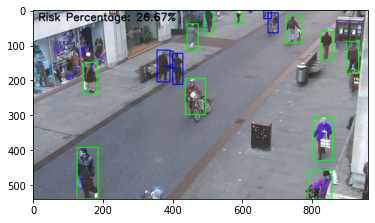

** Frame # 2 **

Person # 0, located: (504, 32) confidence: 61.38
Person # 1, located: (671, 11) confidence: 76.59
Person # 2, located: (915, 135) confidence: 84.44
Person # 3, located: (588, 18) confidence: 85.65
Person # 4, located: (687, 36) confidence: 86.06
Person # 5, located: (163, 193) confidence: 88.95
Person # 6, located: (821, 498) confidence: 91.17
Person # 7, located: (464, 246) confidence: 92.79
Person # 8, located: (456, 77) confidence: 95.1
Person # 9, located: (840, 101) confidence: 96.5
Person # 10, located: (155, 466) confidence: 97.83
Person # 11, located: (373, 159) confidence: 98.01
Person # 12, located: (830, 367) confidence: 98.52
Person # 13, located: (414, 167) confidence: 98.68
Person # 14, located: (747, 54) confidence: 98.74

Total number of people 15
Total number of people who break social distancing measure 4
People ids who break social distancing measure [1, 4, 11, 13]



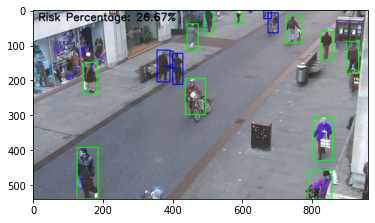

** Frame # 3 **

Person # 0, located: (504, 32) confidence: 61.57
Person # 1, located: (671, 11) confidence: 76.68
Person # 2, located: (915, 135) confidence: 84.45
Person # 3, located: (588, 18) confidence: 85.65
Person # 4, located: (687, 36) confidence: 86.07
Person # 5, located: (163, 193) confidence: 88.89
Person # 6, located: (821, 498) confidence: 91.06
Person # 7, located: (464, 246) confidence: 92.76
Person # 8, located: (456, 77) confidence: 95.1
Person # 9, located: (840, 101) confidence: 96.56
Person # 10, located: (156, 466) confidence: 97.85
Person # 11, located: (373, 159) confidence: 98.03
Person # 12, located: (830, 367) confidence: 98.53
Person # 13, located: (414, 167) confidence: 98.7
Person # 14, located: (747, 54) confidence: 98.74

Total number of people 15
Total number of people who break social distancing measure 4
People ids who break social distancing measure [1, 4, 11, 13]



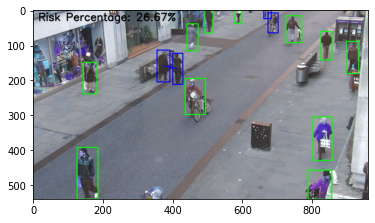

** Frame # 4 **

Person # 0, located: (504, 32) confidence: 61.54
Person # 1, located: (671, 11) confidence: 76.67
Person # 2, located: (915, 135) confidence: 84.43
Person # 3, located: (588, 18) confidence: 85.66
Person # 4, located: (687, 36) confidence: 86.07
Person # 5, located: (163, 193) confidence: 88.89
Person # 6, located: (821, 498) confidence: 91.05
Person # 7, located: (464, 246) confidence: 92.76
Person # 8, located: (456, 77) confidence: 95.09
Person # 9, located: (840, 101) confidence: 96.56
Person # 10, located: (156, 466) confidence: 97.85
Person # 11, located: (373, 159) confidence: 98.03
Person # 12, located: (830, 367) confidence: 98.53
Person # 13, located: (414, 167) confidence: 98.7
Person # 14, located: (747, 54) confidence: 98.74

Total number of people 15
Total number of people who break social distancing measure 4
People ids who break social distancing measure [1, 4, 11, 13]



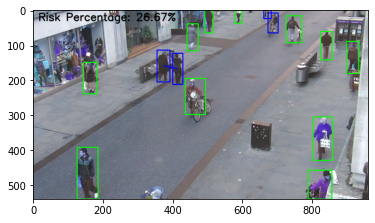

** Frame # 5 **

Person # 0, located: (623, 3) confidence: 58.62
Person # 1, located: (506, 32) confidence: 67.16
Person # 2, located: (161, 193) confidence: 83.13
Person # 3, located: (671, 11) confidence: 85.21
Person # 4, located: (917, 132) confidence: 85.79
Person # 5, located: (587, 18) confidence: 88.42
Person # 6, located: (690, 35) confidence: 89.37
Person # 7, located: (821, 499) confidence: 92.54
Person # 8, located: (457, 77) confidence: 95.25
Person # 9, located: (150, 467) confidence: 95.97
Person # 10, located: (840, 101) confidence: 96.2
Person # 11, located: (461, 248) confidence: 96.65
Person # 12, located: (829, 367) confidence: 96.92
Person # 13, located: (375, 158) confidence: 97.9
Person # 14, located: (748, 54) confidence: 98.7
Person # 15, located: (415, 165) confidence: 98.92

Total number of people 16
Total number of people who break social distancing measure 6
People ids who break social distancing measure [0, 3, 5, 6, 13, 15]



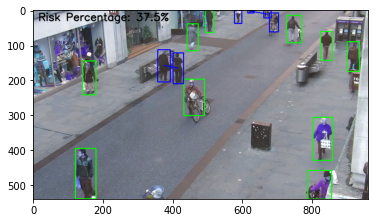

** Frame # 6 **

Person # 0, located: (625, 3) confidence: 57.28
Person # 1, located: (362, 519) confidence: 57.84
Person # 2, located: (160, 180) confidence: 80.37
Person # 3, located: (506, 32) confidence: 81.89
Person # 4, located: (671, 11) confidence: 82.51
Person # 5, located: (691, 35) confidence: 86.08
Person # 6, located: (587, 18) confidence: 87.37
Person # 7, located: (917, 130) confidence: 88.08
Person # 8, located: (823, 500) confidence: 91.52
Person # 9, located: (375, 159) confidence: 94.63
Person # 10, located: (840, 101) confidence: 95.46
Person # 11, located: (459, 251) confidence: 95.63
Person # 12, located: (457, 75) confidence: 95.69
Person # 13, located: (829, 368) confidence: 97.68
Person # 14, located: (146, 469) confidence: 98.42
Person # 15, located: (748, 53) confidence: 98.47
Person # 16, located: (417, 166) confidence: 98.93

Total number of people 17
Total number of people who break social distancing measure 7
People ids who break social distancing measure

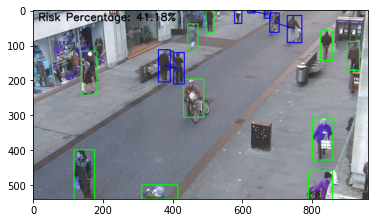

** Frame # 7 **

Person # 0, located: (624, 3) confidence: 51.29
Person # 1, located: (156, 180) confidence: 65.04
Person # 2, located: (362, 518) confidence: 67.03
Person # 3, located: (671, 11) confidence: 81.64
Person # 4, located: (918, 129) confidence: 81.77
Person # 5, located: (507, 31) confidence: 83.38
Person # 6, located: (587, 18) confidence: 87.97
Person # 7, located: (693, 34) confidence: 89.6
Person # 8, located: (823, 501) confidence: 90.17
Person # 9, located: (380, 158) confidence: 90.45
Person # 10, located: (458, 254) confidence: 93.71
Person # 11, located: (840, 101) confidence: 95.56
Person # 12, located: (458, 75) confidence: 96.15
Person # 13, located: (830, 370) confidence: 97.87
Person # 14, located: (749, 53) confidence: 98.16
Person # 15, located: (141, 470) confidence: 98.68
Person # 16, located: (421, 165) confidence: 98.81

Total number of people 17
Total number of people who break social distancing measure 7
People ids who break social distancing measure 

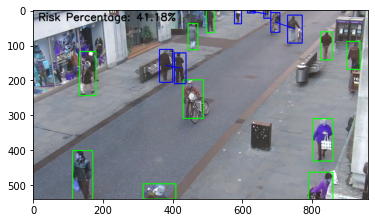

** Frame # 8 **

Person # 0, located: (671, 11) confidence: 75.89
Person # 1, located: (364, 516) confidence: 77.6
Person # 2, located: (919, 129) confidence: 80.51
Person # 3, located: (508, 30) confidence: 83.02
Person # 4, located: (586, 18) confidence: 86.69
Person # 5, located: (826, 503) confidence: 86.78
Person # 6, located: (696, 33) confidence: 92.7
Person # 7, located: (381, 158) confidence: 93.5
Person # 8, located: (458, 74) confidence: 94.83
Person # 9, located: (456, 258) confidence: 95.23
Person # 10, located: (840, 101) confidence: 96.3
Person # 11, located: (750, 53) confidence: 98.44
Person # 12, located: (423, 166) confidence: 98.65
Person # 13, located: (139, 472) confidence: 99.14
Person # 14, located: (830, 370) confidence: 99.17

Total number of people 15
Total number of people who break social distancing measure 5
People ids who break social distancing measure [0, 6, 11, 7, 12]



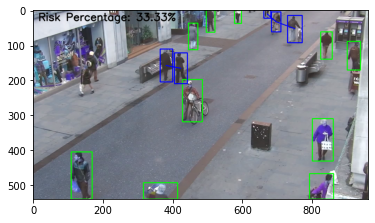

** Frame # 9 **

Person # 0, located: (150, 205) confidence: 54.41
Person # 1, located: (172, 161) confidence: 54.95
Person # 2, located: (671, 11) confidence: 76.87
Person # 3, located: (361, 516) confidence: 80.63
Person # 4, located: (824, 506) confidence: 83.52
Person # 5, located: (919, 129) confidence: 84.28
Person # 6, located: (509, 30) confidence: 85.26
Person # 7, located: (586, 18) confidence: 86.74
Person # 8, located: (698, 33) confidence: 91.33
Person # 9, located: (383, 157) confidence: 93.03
Person # 10, located: (840, 100) confidence: 93.64
Person # 11, located: (459, 74) confidence: 95.37
Person # 12, located: (452, 261) confidence: 96.81
Person # 13, located: (750, 54) confidence: 98.4
Person # 14, located: (137, 473) confidence: 98.63
Person # 15, located: (424, 165) confidence: 98.86
Person # 16, located: (830, 372) confidence: 99.6

Total number of people 17
Total number of people who break social distancing measure 7
People ids who break social distancing measure

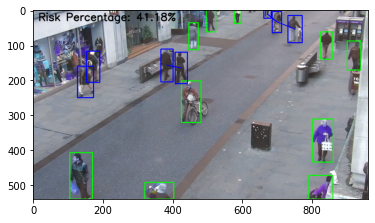

** Frame # 10 **

Person # 0, located: (172, 161) confidence: 58.61
Person # 1, located: (671, 11) confidence: 71.09
Person # 2, located: (824, 508) confidence: 75.9
Person # 3, located: (148, 204) confidence: 79.19
Person # 4, located: (700, 31) confidence: 79.23
Person # 5, located: (920, 129) confidence: 83.62
Person # 6, located: (363, 514) confidence: 85.55
Person # 7, located: (509, 30) confidence: 86.44
Person # 8, located: (585, 18) confidence: 87.11
Person # 9, located: (384, 158) confidence: 91.09
Person # 10, located: (840, 97) confidence: 92.63
Person # 11, located: (460, 74) confidence: 93.01
Person # 12, located: (450, 262) confidence: 95.14
Person # 13, located: (750, 53) confidence: 97.97
Person # 14, located: (135, 475) confidence: 98.45
Person # 15, located: (425, 164) confidence: 98.7
Person # 16, located: (830, 375) confidence: 99.34

Total number of people 17
Total number of people who break social distancing measure 7
People ids who break social distancing measure

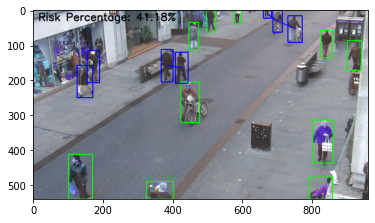

** Frame # 11 **

Person # 0, located: (825, 509) confidence: 62.97
Person # 1, located: (671, 10) confidence: 69.3
Person # 2, located: (702, 30) confidence: 78.34
Person # 3, located: (145, 205) confidence: 82.48
Person # 4, located: (585, 18) confidence: 83.52
Person # 5, located: (922, 129) confidence: 84.06
Person # 6, located: (510, 30) confidence: 84.13
Person # 7, located: (363, 513) confidence: 86.72
Person # 8, located: (460, 73) confidence: 93.05
Person # 9, located: (385, 158) confidence: 93.46
Person # 10, located: (840, 96) confidence: 95.76
Person # 11, located: (449, 263) confidence: 96.12
Person # 12, located: (751, 53) confidence: 97.76
Person # 13, located: (426, 163) confidence: 98.97
Person # 14, located: (830, 376) confidence: 99.01
Person # 15, located: (133, 479) confidence: 99.08

Total number of people 16
Total number of people who break social distancing measure 5
People ids who break social distancing measure [1, 2, 12, 9, 13]



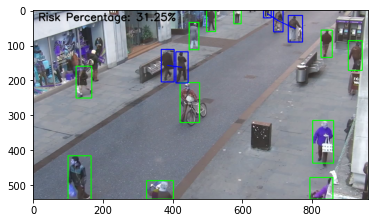

** Frame # 12 **

Person # 0, located: (825, 509) confidence: 61.93
Person # 1, located: (671, 10) confidence: 69.28
Person # 2, located: (702, 30) confidence: 78.52
Person # 3, located: (145, 205) confidence: 82.48
Person # 4, located: (585, 18) confidence: 83.35
Person # 5, located: (922, 129) confidence: 83.98
Person # 6, located: (510, 30) confidence: 84.31
Person # 7, located: (363, 513) confidence: 86.65
Person # 8, located: (461, 73) confidence: 93.18
Person # 9, located: (385, 158) confidence: 93.47
Person # 10, located: (840, 96) confidence: 95.73
Person # 11, located: (449, 263) confidence: 96.09
Person # 12, located: (751, 53) confidence: 97.74
Person # 13, located: (426, 163) confidence: 98.97
Person # 14, located: (830, 376) confidence: 99.0
Person # 15, located: (132, 479) confidence: 99.08

Total number of people 16
Total number of people who break social distancing measure 5
People ids who break social distancing measure [1, 2, 12, 9, 13]



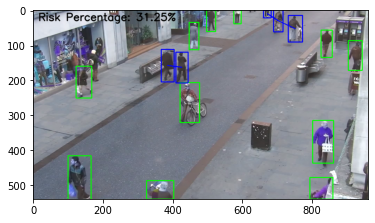

** Frame # 13 **

Person # 0, located: (704, 31) confidence: 58.89
Person # 1, located: (671, 10) confidence: 64.86
Person # 2, located: (922, 124) confidence: 65.33
Person # 3, located: (511, 30) confidence: 78.5
Person # 4, located: (365, 513) confidence: 78.96
Person # 5, located: (584, 19) confidence: 79.12
Person # 6, located: (139, 204) confidence: 82.54
Person # 7, located: (463, 74) confidence: 91.25
Person # 8, located: (386, 158) confidence: 93.43
Person # 9, located: (840, 95) confidence: 94.06
Person # 10, located: (446, 264) confidence: 95.97
Person # 11, located: (751, 52) confidence: 97.21
Person # 12, located: (831, 379) confidence: 98.42
Person # 13, located: (427, 162) confidence: 98.43
Person # 14, located: (129, 480) confidence: 98.54

Total number of people 15
Total number of people who break social distancing measure 5
People ids who break social distancing measure [0, 1, 11, 8, 13]



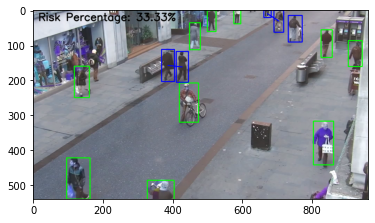

** Frame # 14 **

Person # 0, located: (178, 159) confidence: 60.33
Person # 1, located: (671, 10) confidence: 65.67
Person # 2, located: (706, 26) confidence: 70.94
Person # 3, located: (923, 124) confidence: 72.3
Person # 4, located: (366, 510) confidence: 77.07
Person # 5, located: (584, 19) confidence: 77.57
Person # 6, located: (511, 30) confidence: 87.42
Person # 7, located: (136, 206) confidence: 87.86
Person # 8, located: (388, 157) confidence: 91.9
Person # 9, located: (464, 74) confidence: 93.45
Person # 10, located: (840, 93) confidence: 94.45
Person # 11, located: (124, 481) confidence: 94.87
Person # 12, located: (430, 160) confidence: 95.51
Person # 13, located: (751, 51) confidence: 97.36
Person # 14, located: (444, 264) confidence: 97.62
Person # 15, located: (832, 381) confidence: 98.28

Total number of people 16
Total number of people who break social distancing measure 5
People ids who break social distancing measure [1, 2, 13, 8, 12]



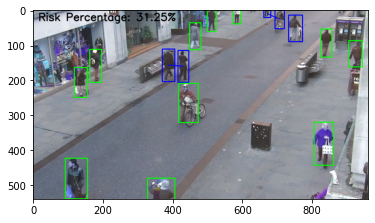

** Frame # 15 **

Person # 0, located: (708, 26) confidence: 67.18
Person # 1, located: (671, 10) confidence: 67.67
Person # 2, located: (584, 18) confidence: 70.76
Person # 3, located: (180, 158) confidence: 74.49
Person # 4, located: (924, 125) confidence: 77.35
Person # 5, located: (134, 204) confidence: 86.29
Person # 6, located: (512, 30) confidence: 87.2
Person # 7, located: (369, 509) confidence: 89.43
Person # 8, located: (464, 74) confidence: 93.29
Person # 9, located: (389, 153) confidence: 94.35
Person # 10, located: (840, 93) confidence: 94.75
Person # 11, located: (119, 482) confidence: 96.69
Person # 12, located: (431, 158) confidence: 96.96
Person # 13, located: (832, 383) confidence: 97.43
Person # 14, located: (443, 265) confidence: 97.63
Person # 15, located: (752, 51) confidence: 97.85

Total number of people 16
Total number of people who break social distancing measure 5
People ids who break social distancing measure [0, 1, 15, 9, 12]



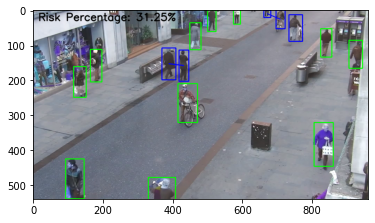

** Frame # 16 **

Person # 0, located: (130, 205) confidence: 67.06
Person # 1, located: (671, 10) confidence: 69.13
Person # 2, located: (583, 19) confidence: 70.03
Person # 3, located: (710, 25) confidence: 77.6
Person # 4, located: (926, 126) confidence: 78.42
Person # 5, located: (182, 158) confidence: 78.96
Person # 6, located: (513, 30) confidence: 84.74
Person # 7, located: (116, 482) confidence: 89.95
Person # 8, located: (371, 507) confidence: 90.75
Person # 9, located: (839, 92) confidence: 95.07
Person # 10, located: (391, 151) confidence: 96.17
Person # 11, located: (465, 73) confidence: 96.38
Person # 12, located: (433, 157) confidence: 96.58
Person # 13, located: (833, 386) confidence: 97.54
Person # 14, located: (752, 50) confidence: 97.98
Person # 15, located: (441, 265) confidence: 98.04

Total number of people 16
Total number of people who break social distancing measure 5
People ids who break social distancing measure [1, 3, 14, 10, 12]



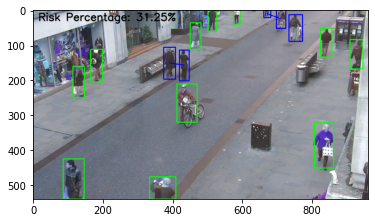

** Frame # 17 **

Person # 0, located: (902, 337) confidence: 52.32
Person # 1, located: (711, 25) confidence: 68.17
Person # 2, located: (583, 19) confidence: 68.35
Person # 3, located: (927, 126) confidence: 73.05
Person # 4, located: (671, 10) confidence: 74.67
Person # 5, located: (185, 158) confidence: 76.06
Person # 6, located: (514, 29) confidence: 82.02
Person # 7, located: (128, 206) confidence: 83.11
Person # 8, located: (373, 506) confidence: 89.84
Person # 9, located: (839, 92) confidence: 93.88
Person # 10, located: (434, 157) confidence: 95.46
Person # 11, located: (466, 73) confidence: 96.03
Person # 12, located: (110, 484) confidence: 96.43
Person # 13, located: (833, 387) confidence: 96.96
Person # 14, located: (393, 149) confidence: 97.03
Person # 15, located: (752, 50) confidence: 97.85
Person # 16, located: (440, 266) confidence: 97.91

Total number of people 17
Total number of people who break social distancing measure 5
People ids who break social distancing measu

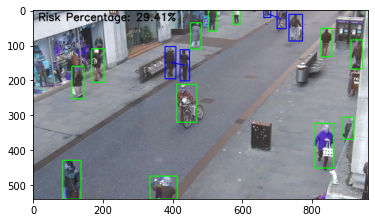

** Frame # 18 **

Person # 0, located: (713, 23) confidence: 53.05
Person # 1, located: (582, 19) confidence: 63.5
Person # 2, located: (671, 10) confidence: 67.82
Person # 3, located: (928, 125) confidence: 73.1
Person # 4, located: (187, 157) confidence: 77.29
Person # 5, located: (515, 29) confidence: 78.87
Person # 6, located: (374, 505) confidence: 86.56
Person # 7, located: (467, 72) confidence: 91.2
Person # 8, located: (437, 266) confidence: 93.31
Person # 9, located: (839, 92) confidence: 93.54
Person # 10, located: (436, 157) confidence: 96.55
Person # 11, located: (395, 149) confidence: 96.98
Person # 12, located: (752, 49) confidence: 97.09
Person # 13, located: (834, 389) confidence: 97.34
Person # 14, located: (108, 485) confidence: 97.94

Total number of people 15
Total number of people who break social distancing measure 5
People ids who break social distancing measure [0, 2, 12, 10, 11]



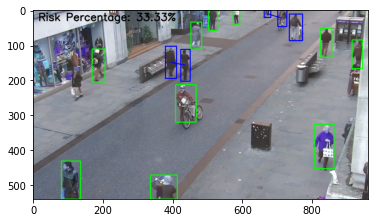

** Frame # 19 **

Person # 0, located: (715, 23) confidence: 52.35
Person # 1, located: (899, 347) confidence: 54.89
Person # 2, located: (671, 10) confidence: 57.92
Person # 3, located: (930, 124) confidence: 64.18
Person # 4, located: (582, 19) confidence: 67.97
Person # 5, located: (188, 158) confidence: 74.51
Person # 6, located: (517, 29) confidence: 80.83
Person # 7, located: (375, 504) confidence: 90.41
Person # 8, located: (123, 209) confidence: 90.99
Person # 9, located: (469, 72) confidence: 92.69
Person # 10, located: (436, 271) confidence: 92.85
Person # 11, located: (839, 92) confidence: 93.42
Person # 12, located: (107, 486) confidence: 95.57
Person # 13, located: (396, 148) confidence: 96.32
Person # 14, located: (753, 48) confidence: 96.54
Person # 15, located: (437, 157) confidence: 96.57
Person # 16, located: (835, 392) confidence: 98.45

Total number of people 17
Total number of people who break social distancing measure 5
People ids who break social distancing measu

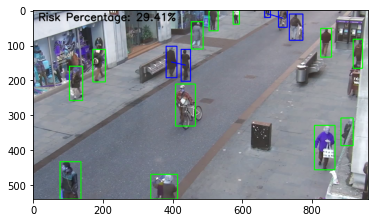

** Frame # 20 **

Person # 0, located: (579, 19) confidence: 57.13
Person # 1, located: (717, 24) confidence: 61.19
Person # 2, located: (932, 120) confidence: 62.31
Person # 3, located: (189, 154) confidence: 69.16
Person # 4, located: (898, 351) confidence: 73.32
Person # 5, located: (122, 214) confidence: 76.09
Person # 6, located: (518, 29) confidence: 78.83
Person # 7, located: (103, 488) confidence: 90.69
Person # 8, located: (433, 271) confidence: 93.16
Person # 9, located: (839, 92) confidence: 93.49
Person # 10, located: (471, 70) confidence: 94.17
Person # 11, located: (438, 157) confidence: 94.44
Person # 12, located: (381, 503) confidence: 94.86
Person # 13, located: (753, 48) confidence: 96.67
Person # 14, located: (397, 147) confidence: 97.21
Person # 15, located: (835, 394) confidence: 99.07

Total number of people 16
Total number of people who break social distancing measure 4
People ids who break social distancing measure [1, 13, 11, 14]



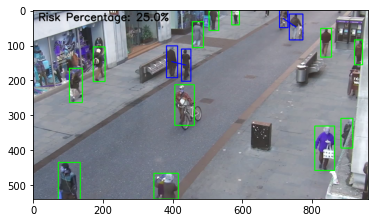

** Frame # 21 **

Person # 0, located: (933, 125) confidence: 56.39
Person # 1, located: (579, 20) confidence: 66.1
Person # 2, located: (719, 23) confidence: 72.98
Person # 3, located: (898, 352) confidence: 77.07
Person # 4, located: (191, 152) confidence: 78.42
Person # 5, located: (518, 27) confidence: 79.38
Person # 6, located: (120, 216) confidence: 89.24
Person # 7, located: (474, 69) confidence: 92.98
Person # 8, located: (839, 92) confidence: 93.63
Person # 9, located: (433, 272) confidence: 94.62
Person # 10, located: (440, 155) confidence: 95.95
Person # 11, located: (382, 502) confidence: 96.39
Person # 12, located: (753, 47) confidence: 96.71
Person # 13, located: (398, 146) confidence: 96.89
Person # 14, located: (96, 490) confidence: 97.64
Person # 15, located: (836, 396) confidence: 98.21

Total number of people 16
Total number of people who break social distancing measure 4
People ids who break social distancing measure [2, 12, 10, 13]



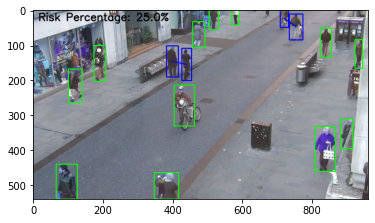

** Frame # 22 **

Person # 0, located: (672, 10) confidence: 56.53
Person # 1, located: (721, 23) confidence: 67.84
Person # 2, located: (578, 21) confidence: 73.3
Person # 3, located: (192, 149) confidence: 73.32
Person # 4, located: (897, 353) confidence: 79.64
Person # 5, located: (518, 27) confidence: 85.33
Person # 6, located: (431, 274) confidence: 92.38
Person # 7, located: (117, 217) confidence: 92.98
Person # 8, located: (838, 92) confidence: 93.52
Person # 9, located: (475, 72) confidence: 94.02
Person # 10, located: (95, 491) confidence: 96.1
Person # 11, located: (386, 501) confidence: 96.16
Person # 12, located: (754, 47) confidence: 96.56
Person # 13, located: (441, 154) confidence: 97.66
Person # 14, located: (400, 146) confidence: 97.73
Person # 15, located: (836, 400) confidence: 98.18

Total number of people 16
Total number of people who break social distancing measure 5
People ids who break social distancing measure [0, 1, 12, 13, 14]



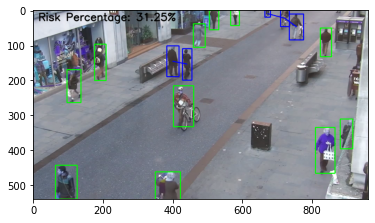

** Frame # 23 **

Person # 0, located: (896, 356) confidence: 57.67
Person # 1, located: (672, 9) confidence: 65.17
Person # 2, located: (722, 24) confidence: 70.82
Person # 3, located: (519, 27) confidence: 76.96
Person # 4, located: (578, 21) confidence: 77.22
Person # 5, located: (194, 149) confidence: 81.0
Person # 6, located: (113, 218) confidence: 89.18
Person # 7, located: (838, 91) confidence: 92.94
Person # 8, located: (476, 72) confidence: 93.34
Person # 9, located: (429, 278) confidence: 95.58
Person # 10, located: (755, 47) confidence: 96.24
Person # 11, located: (402, 147) confidence: 96.63
Person # 12, located: (386, 499) confidence: 97.73
Person # 13, located: (90, 494) confidence: 98.01
Person # 14, located: (442, 154) confidence: 98.15
Person # 15, located: (838, 404) confidence: 98.6

Total number of people 16
Total number of people who break social distancing measure 7
People ids who break social distancing measure [1, 2, 10, 3, 4, 11, 14]



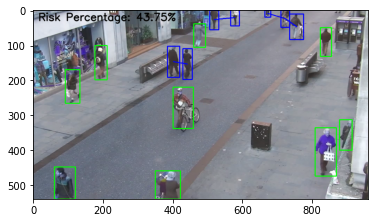

** Frame # 24 **

Person # 0, located: (895, 357) confidence: 59.52
Person # 1, located: (724, 24) confidence: 73.98
Person # 2, located: (194, 147) confidence: 75.46
Person # 3, located: (673, 9) confidence: 75.85
Person # 4, located: (520, 29) confidence: 81.38
Person # 5, located: (578, 21) confidence: 82.16
Person # 6, located: (109, 217) confidence: 91.35
Person # 7, located: (838, 90) confidence: 92.28
Person # 8, located: (477, 69) confidence: 94.95
Person # 9, located: (426, 280) confidence: 95.28
Person # 10, located: (754, 46) confidence: 95.98
Person # 11, located: (406, 147) confidence: 96.21
Person # 12, located: (387, 498) confidence: 97.2
Person # 13, located: (838, 408) confidence: 97.9
Person # 14, located: (86, 495) confidence: 98.09
Person # 15, located: (444, 152) confidence: 98.19

Total number of people 16
Total number of people who break social distancing measure 8
People ids who break social distancing measure [1, 3, 10, 4, 5, 8, 11, 15]



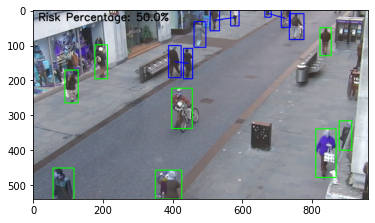

** Frame # 25 **

Person # 0, located: (195, 145) confidence: 66.76
Person # 1, located: (673, 9) confidence: 72.74
Person # 2, located: (726, 24) confidence: 72.75
Person # 3, located: (577, 22) confidence: 83.64
Person # 4, located: (520, 27) confidence: 85.03
Person # 5, located: (106, 219) confidence: 92.99
Person # 6, located: (424, 282) confidence: 93.06
Person # 7, located: (838, 88) confidence: 94.04
Person # 8, located: (388, 497) confidence: 95.14
Person # 9, located: (478, 68) confidence: 95.41
Person # 10, located: (82, 498) confidence: 96.0
Person # 11, located: (754, 46) confidence: 96.12
Person # 12, located: (406, 146) confidence: 96.42
Person # 13, located: (840, 411) confidence: 97.41
Person # 14, located: (445, 150) confidence: 97.73

Total number of people 15
Total number of people who break social distancing measure 8
People ids who break social distancing measure [1, 2, 11, 3, 4, 9, 12, 14]



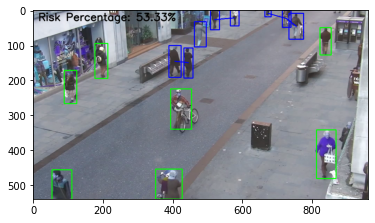

** Frame # 26 **

Person # 0, located: (893, 361) confidence: 55.79
Person # 1, located: (673, 9) confidence: 70.04
Person # 2, located: (727, 23) confidence: 73.43
Person # 3, located: (196, 145) confidence: 75.88
Person # 4, located: (577, 22) confidence: 84.5
Person # 5, located: (521, 27) confidence: 85.56
Person # 6, located: (423, 286) confidence: 90.21
Person # 7, located: (478, 69) confidence: 91.82
Person # 8, located: (103, 218) confidence: 91.93
Person # 9, located: (406, 146) confidence: 92.52
Person # 10, located: (838, 88) confidence: 93.42
Person # 11, located: (390, 495) confidence: 94.23
Person # 12, located: (754, 44) confidence: 95.17
Person # 13, located: (78, 499) confidence: 95.4
Person # 14, located: (842, 415) confidence: 96.93
Person # 15, located: (446, 149) confidence: 97.89

Total number of people 16
Total number of people who break social distancing measure 7
People ids who break social distancing measure [1, 2, 12, 4, 5, 9, 15]



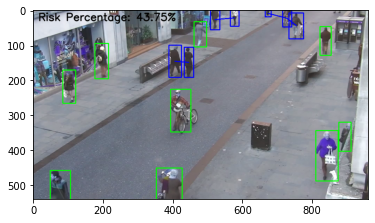

** Frame # 27 **

Person # 0, located: (729, 24) confidence: 61.85
Person # 1, located: (673, 9) confidence: 69.25
Person # 2, located: (197, 145) confidence: 70.41
Person # 3, located: (577, 22) confidence: 83.86
Person # 4, located: (521, 27) confidence: 85.01
Person # 5, located: (420, 287) confidence: 89.33
Person # 6, located: (102, 219) confidence: 89.65
Person # 7, located: (481, 69) confidence: 90.73
Person # 8, located: (408, 145) confidence: 93.07
Person # 9, located: (838, 87) confidence: 95.22
Person # 10, located: (755, 44) confidence: 95.23
Person # 11, located: (841, 416) confidence: 96.2
Person # 12, located: (392, 495) confidence: 96.91
Person # 13, located: (72, 500) confidence: 97.53
Person # 14, located: (447, 148) confidence: 98.08

Total number of people 15
Total number of people who break social distancing measure 8
People ids who break social distancing measure [0, 1, 10, 3, 4, 7, 8, 14]



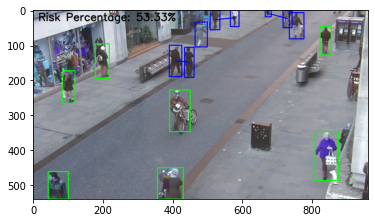

** Frame # 28 **

Person # 0, located: (892, 364) confidence: 58.4
Person # 1, located: (870, 5) confidence: 59.02
Person # 2, located: (673, 9) confidence: 64.57
Person # 3, located: (200, 146) confidence: 69.26
Person # 4, located: (418, 287) confidence: 81.73
Person # 5, located: (522, 27) confidence: 85.72
Person # 6, located: (576, 22) confidence: 85.84
Person # 7, located: (482, 69) confidence: 87.03
Person # 8, located: (756, 43) confidence: 87.71
Person # 9, located: (98, 220) confidence: 90.21
Person # 10, located: (838, 86) confidence: 93.1
Person # 11, located: (410, 143) confidence: 93.17
Person # 12, located: (396, 493) confidence: 94.52
Person # 13, located: (68, 501) confidence: 96.74
Person # 14, located: (840, 418) confidence: 97.85
Person # 15, located: (448, 148) confidence: 98.79

Total number of people 16
Total number of people who break social distancing measure 5
People ids who break social distancing measure [5, 6, 7, 11, 15]



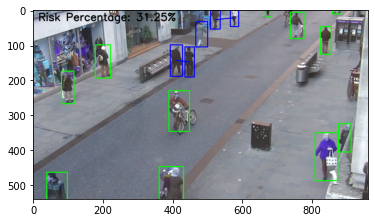

** Frame # 29 **

Person # 0, located: (674, 9) confidence: 59.72
Person # 1, located: (870, 5) confidence: 62.59
Person # 2, located: (417, 275) confidence: 65.26
Person # 3, located: (892, 365) confidence: 67.36
Person # 4, located: (206, 146) confidence: 83.01
Person # 5, located: (759, 44) confidence: 83.37
Person # 6, located: (522, 27) confidence: 85.91
Person # 7, located: (838, 86) confidence: 88.09
Person # 8, located: (97, 224) confidence: 88.54
Person # 9, located: (576, 22) confidence: 89.07
Person # 10, located: (483, 69) confidence: 89.68
Person # 11, located: (397, 492) confidence: 90.42
Person # 12, located: (411, 140) confidence: 94.72
Person # 13, located: (62, 502) confidence: 96.11
Person # 14, located: (450, 147) confidence: 98.26
Person # 15, located: (840, 419) confidence: 98.5

Total number of people 16
Total number of people who break social distancing measure 5
People ids who break social distancing measure [6, 9, 10, 12, 14]



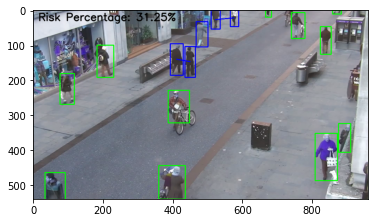

** Frame # 30 **

Person # 0, located: (891, 361) confidence: 52.24
Person # 1, located: (870, 5) confidence: 60.24
Person # 2, located: (674, 9) confidence: 62.85
Person # 3, located: (208, 145) confidence: 79.19
Person # 4, located: (838, 86) confidence: 81.74
Person # 5, located: (414, 276) confidence: 82.58
Person # 6, located: (759, 41) confidence: 83.0
Person # 7, located: (523, 27) confidence: 85.86
Person # 8, located: (397, 491) confidence: 87.81
Person # 9, located: (95, 224) confidence: 88.36
Person # 10, located: (484, 68) confidence: 88.63
Person # 11, located: (575, 23) confidence: 88.9
Person # 12, located: (413, 140) confidence: 95.98
Person # 13, located: (58, 502) confidence: 96.77
Person # 14, located: (452, 147) confidence: 96.98
Person # 15, located: (840, 420) confidence: 98.68

Total number of people 16
Total number of people who break social distancing measure 5
People ids who break social distancing measure [7, 10, 11, 12, 14]



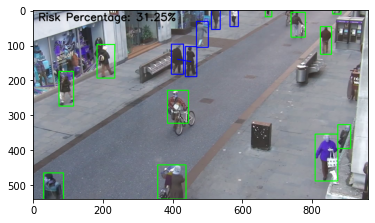

** Frame # 31 **

Person # 0, located: (869, 5) confidence: 61.42
Person # 1, located: (673, 9) confidence: 63.98
Person # 2, located: (838, 83) confidence: 78.44
Person # 3, located: (209, 146) confidence: 81.4
Person # 4, located: (412, 276) confidence: 81.72
Person # 5, located: (759, 41) confidence: 83.81
Person # 6, located: (574, 23) confidence: 85.09
Person # 7, located: (408, 488) confidence: 86.53
Person # 8, located: (524, 26) confidence: 87.37
Person # 9, located: (485, 68) confidence: 89.13
Person # 10, located: (92, 224) confidence: 90.31
Person # 11, located: (415, 139) confidence: 93.54
Person # 12, located: (453, 147) confidence: 93.74
Person # 13, located: (56, 504) confidence: 94.83
Person # 14, located: (841, 421) confidence: 98.06

Total number of people 15
Total number of people who break social distancing measure 5
People ids who break social distancing measure [6, 8, 9, 11, 12]



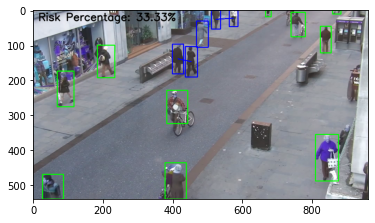

** Frame # 32 **

Person # 0, located: (890, 362) confidence: 51.5
Person # 1, located: (737, 22) confidence: 57.7
Person # 2, located: (838, 83) confidence: 80.35
Person # 3, located: (573, 23) confidence: 84.58
Person # 4, located: (212, 147) confidence: 86.14
Person # 5, located: (410, 281) confidence: 86.91
Person # 6, located: (756, 41) confidence: 87.22
Person # 7, located: (524, 26) confidence: 87.29
Person # 8, located: (90, 225) confidence: 89.49
Person # 9, located: (455, 147) confidence: 93.87
Person # 10, located: (485, 68) confidence: 93.91
Person # 11, located: (406, 489) confidence: 94.16
Person # 12, located: (417, 138) confidence: 94.18
Person # 13, located: (52, 506) confidence: 95.35
Person # 14, located: (842, 422) confidence: 97.89

Total number of people 15
Total number of people who break social distancing measure 7
People ids who break social distancing measure [1, 6, 3, 7, 10, 9, 12]



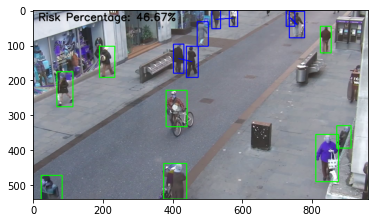

** Frame # 33 **

Person # 0, located: (839, 83) confidence: 79.44
Person # 1, located: (756, 40) confidence: 85.97
Person # 2, located: (525, 26) confidence: 88.0
Person # 3, located: (572, 23) confidence: 88.01
Person # 4, located: (213, 147) confidence: 89.16
Person # 5, located: (408, 289) confidence: 89.68
Person # 6, located: (87, 229) confidence: 92.72
Person # 7, located: (455, 146) confidence: 94.12
Person # 8, located: (487, 67) confidence: 94.48
Person # 9, located: (418, 138) confidence: 95.33
Person # 10, located: (45, 507) confidence: 95.49
Person # 11, located: (410, 487) confidence: 95.76
Person # 12, located: (843, 423) confidence: 98.06

Total number of people 13
Total number of people who break social distancing measure 5
People ids who break social distancing measure [2, 3, 8, 7, 9]



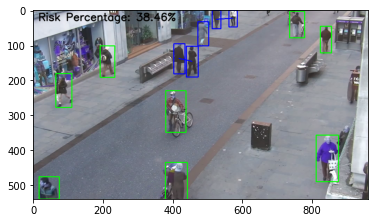

** Frame # 34 **

Person # 0, located: (868, 5) confidence: 51.42
Person # 1, located: (839, 83) confidence: 77.92
Person # 2, located: (81, 229) confidence: 85.78
Person # 3, located: (572, 23) confidence: 87.17
Person # 4, located: (759, 40) confidence: 87.77
Person # 5, located: (214, 146) confidence: 90.19
Person # 6, located: (525, 26) confidence: 91.63
Person # 7, located: (407, 292) confidence: 92.58
Person # 8, located: (488, 68) confidence: 93.76
Person # 9, located: (456, 146) confidence: 94.72
Person # 10, located: (420, 138) confidence: 95.22
Person # 11, located: (410, 486) confidence: 96.11
Person # 12, located: (41, 510) confidence: 96.36
Person # 13, located: (843, 424) confidence: 98.42

Total number of people 14
Total number of people who break social distancing measure 5
People ids who break social distancing measure [3, 6, 8, 9, 10]



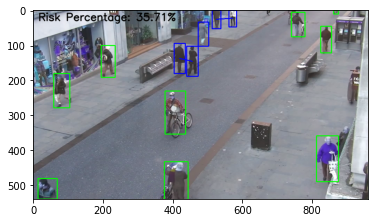

** Frame # 35 **

Person # 0, located: (886, 374) confidence: 51.82
Person # 1, located: (78, 230) confidence: 87.16
Person # 2, located: (839, 83) confidence: 88.23
Person # 3, located: (215, 145) confidence: 88.71
Person # 4, located: (759, 40) confidence: 89.05
Person # 5, located: (572, 23) confidence: 90.18
Person # 6, located: (525, 26) confidence: 90.77
Person # 7, located: (402, 294) confidence: 91.31
Person # 8, located: (488, 67) confidence: 93.88
Person # 9, located: (844, 427) confidence: 96.45
Person # 10, located: (458, 144) confidence: 96.63
Person # 11, located: (36, 513) confidence: 97.21
Person # 12, located: (410, 485) confidence: 97.29
Person # 13, located: (422, 138) confidence: 97.31

Total number of people 14
Total number of people who break social distancing measure 5
People ids who break social distancing measure [5, 6, 8, 10, 13]



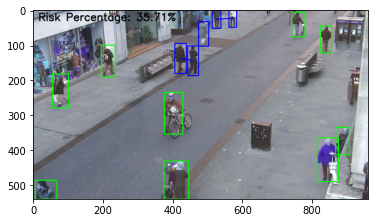

** Frame # 36 **

Person # 0, located: (885, 375) confidence: 52.96
Person # 1, located: (74, 230) confidence: 81.08
Person # 2, located: (216, 143) confidence: 84.93
Person # 3, located: (526, 25) confidence: 91.5
Person # 4, located: (488, 67) confidence: 91.65
Person # 5, located: (840, 83) confidence: 91.9
Person # 6, located: (760, 40) confidence: 92.25
Person # 7, located: (400, 296) confidence: 92.44
Person # 8, located: (571, 23) confidence: 93.07
Person # 9, located: (30, 515) confidence: 95.43
Person # 10, located: (459, 143) confidence: 96.3
Person # 11, located: (411, 484) confidence: 96.65
Person # 12, located: (423, 137) confidence: 96.94
Person # 13, located: (846, 428) confidence: 97.93

Total number of people 14
Total number of people who break social distancing measure 5
People ids who break social distancing measure [3, 4, 8, 10, 12]



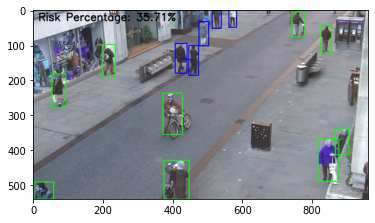

** Frame # 37 **

Person # 0, located: (216, 140) confidence: 82.41
Person # 1, located: (70, 230) confidence: 82.76
Person # 2, located: (398, 298) confidence: 84.95
Person # 3, located: (527, 25) confidence: 91.89
Person # 4, located: (488, 65) confidence: 92.1
Person # 5, located: (760, 39) confidence: 92.21
Person # 6, located: (28, 517) confidence: 94.32
Person # 7, located: (840, 82) confidence: 94.34
Person # 8, located: (571, 23) confidence: 95.26
Person # 9, located: (462, 141) confidence: 95.41
Person # 10, located: (411, 484) confidence: 96.67
Person # 11, located: (425, 137) confidence: 97.3
Person # 12, located: (847, 429) confidence: 98.09

Total number of people 13
Total number of people who break social distancing measure 5
People ids who break social distancing measure [3, 4, 8, 9, 11]



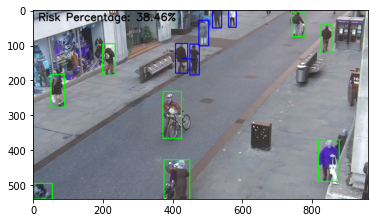

** Frame # 38 **

Person # 0, located: (881, 379) confidence: 60.65
Person # 1, located: (675, 6) confidence: 60.74
Person # 2, located: (27, 518) confidence: 76.31
Person # 3, located: (218, 140) confidence: 80.9
Person # 4, located: (760, 38) confidence: 89.2
Person # 5, located: (66, 232) confidence: 91.48
Person # 6, located: (490, 64) confidence: 91.9
Person # 7, located: (528, 24) confidence: 92.05
Person # 8, located: (570, 24) confidence: 95.15
Person # 9, located: (395, 301) confidence: 95.17
Person # 10, located: (840, 81) confidence: 95.39
Person # 11, located: (464, 140) confidence: 97.28
Person # 12, located: (425, 136) confidence: 97.32
Person # 13, located: (849, 431) confidence: 97.53
Person # 14, located: (414, 481) confidence: 97.72

Total number of people 15
Total number of people who break social distancing measure 5
People ids who break social distancing measure [6, 7, 8, 11, 12]



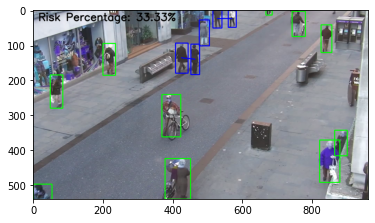

** Frame # 39 **

Person # 0, located: (675, 6) confidence: 60.38
Person # 1, located: (22, 520) confidence: 65.27
Person # 2, located: (64, 234) confidence: 73.14
Person # 3, located: (881, 381) confidence: 79.02
Person # 4, located: (220, 140) confidence: 82.24
Person # 5, located: (760, 37) confidence: 89.5
Person # 6, located: (528, 24) confidence: 89.93
Person # 7, located: (492, 65) confidence: 92.72
Person # 8, located: (840, 80) confidence: 95.62
Person # 9, located: (569, 24) confidence: 95.86
Person # 10, located: (393, 301) confidence: 95.9
Person # 11, located: (416, 480) confidence: 97.08
Person # 12, located: (427, 136) confidence: 97.97
Person # 13, located: (465, 140) confidence: 98.01
Person # 14, located: (848, 432) confidence: 98.1

Total number of people 15
Total number of people who break social distancing measure 5
People ids who break social distancing measure [6, 7, 9, 12, 13]



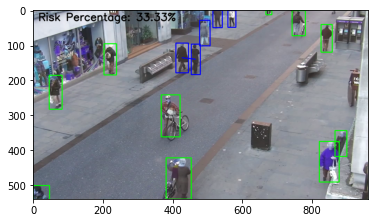

** Frame # 40 **

Person # 0, located: (675, 6) confidence: 54.4
Person # 1, located: (17, 521) confidence: 56.01
Person # 2, located: (880, 381) confidence: 80.9
Person # 3, located: (223, 139) confidence: 81.47
Person # 4, located: (62, 235) confidence: 82.19
Person # 5, located: (528, 24) confidence: 88.74
Person # 6, located: (761, 36) confidence: 90.69
Person # 7, located: (493, 64) confidence: 92.13
Person # 8, located: (840, 80) confidence: 94.5
Person # 9, located: (392, 303) confidence: 95.25
Person # 10, located: (568, 24) confidence: 96.14
Person # 11, located: (418, 479) confidence: 97.49
Person # 12, located: (849, 434) confidence: 97.89
Person # 13, located: (428, 135) confidence: 98.31
Person # 14, located: (467, 140) confidence: 98.38

Total number of people 15
Total number of people who break social distancing measure 5
People ids who break social distancing measure [5, 7, 10, 13, 14]



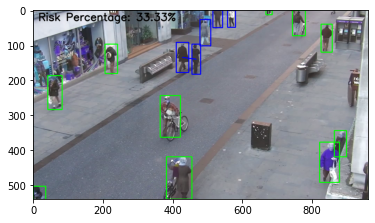

** Frame # 41 **

Person # 0, located: (61, 219) confidence: 78.79
Person # 1, located: (879, 381) confidence: 80.57
Person # 2, located: (529, 24) confidence: 83.09
Person # 3, located: (224, 139) confidence: 86.76
Person # 4, located: (761, 36) confidence: 88.32
Person # 5, located: (494, 64) confidence: 94.4
Person # 6, located: (389, 304) confidence: 94.54
Person # 7, located: (840, 79) confidence: 94.73
Person # 8, located: (430, 133) confidence: 96.01
Person # 9, located: (567, 24) confidence: 96.03
Person # 10, located: (421, 477) confidence: 97.01
Person # 11, located: (468, 139) confidence: 97.75
Person # 12, located: (850, 437) confidence: 98.43

Total number of people 13
Total number of people who break social distancing measure 5
People ids who break social distancing measure [2, 5, 9, 8, 11]



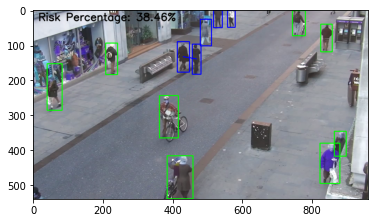

** Frame # 42 **

Person # 0, located: (879, 381) confidence: 74.26
Person # 1, located: (226, 138) confidence: 78.12
Person # 2, located: (531, 24) confidence: 83.55
Person # 3, located: (58, 218) confidence: 84.62
Person # 4, located: (761, 36) confidence: 92.44
Person # 5, located: (387, 300) confidence: 94.1
Person # 6, located: (840, 79) confidence: 94.18
Person # 7, located: (495, 63) confidence: 94.36
Person # 8, located: (567, 25) confidence: 95.74
Person # 9, located: (422, 476) confidence: 96.0
Person # 10, located: (850, 442) confidence: 96.94
Person # 11, located: (431, 131) confidence: 97.43
Person # 12, located: (469, 139) confidence: 98.12

Total number of people 13
Total number of people who break social distancing measure 5
People ids who break social distancing measure [2, 7, 8, 11, 12]



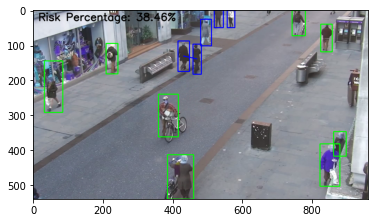

** Frame # 43 **

Person # 0, located: (877, 381) confidence: 77.71
Person # 1, located: (531, 24) confidence: 81.39
Person # 2, located: (228, 138) confidence: 83.39
Person # 3, located: (55, 219) confidence: 87.66
Person # 4, located: (495, 64) confidence: 93.04
Person # 5, located: (761, 36) confidence: 93.2
Person # 6, located: (840, 79) confidence: 93.55
Person # 7, located: (386, 305) confidence: 94.99
Person # 8, located: (566, 26) confidence: 95.31
Person # 9, located: (426, 475) confidence: 95.61
Person # 10, located: (433, 129) confidence: 96.64
Person # 11, located: (851, 448) confidence: 97.91
Person # 12, located: (470, 139) confidence: 98.19

Total number of people 13
Total number of people who break social distancing measure 5
People ids who break social distancing measure [1, 4, 8, 10, 12]



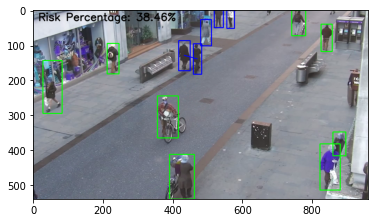

** Frame # 44 **

Person # 0, located: (52, 220) confidence: 55.9
Person # 1, located: (876, 382) confidence: 73.96
Person # 2, located: (532, 24) confidence: 84.73
Person # 3, located: (230, 138) confidence: 87.36
Person # 4, located: (840, 79) confidence: 92.37
Person # 5, located: (761, 36) confidence: 92.6
Person # 6, located: (384, 305) confidence: 93.7
Person # 7, located: (565, 26) confidence: 93.85
Person # 8, located: (496, 64) confidence: 95.39
Person # 9, located: (434, 129) confidence: 96.22
Person # 10, located: (851, 451) confidence: 96.28
Person # 11, located: (428, 474) confidence: 97.31
Person # 12, located: (471, 138) confidence: 98.71

Total number of people 13
Total number of people who break social distancing measure 5
People ids who break social distancing measure [2, 7, 8, 9, 12]



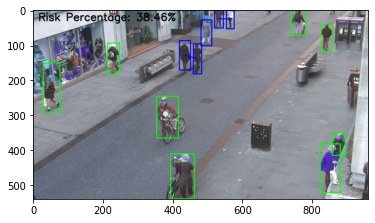

** Frame # 45 **

Person # 0, located: (875, 385) confidence: 73.93
Person # 1, located: (47, 244) confidence: 82.96
Person # 2, located: (384, 305) confidence: 82.96
Person # 3, located: (232, 137) confidence: 86.38
Person # 4, located: (533, 24) confidence: 88.6
Person # 5, located: (840, 79) confidence: 94.34
Person # 6, located: (564, 26) confidence: 94.7
Person # 7, located: (761, 37) confidence: 95.55
Person # 8, located: (436, 129) confidence: 95.69
Person # 9, located: (850, 451) confidence: 96.27
Person # 10, located: (497, 64) confidence: 96.6
Person # 11, located: (430, 473) confidence: 97.01
Person # 12, located: (472, 138) confidence: 98.43

Total number of people 13
Total number of people who break social distancing measure 5
People ids who break social distancing measure [4, 6, 10, 8, 12]



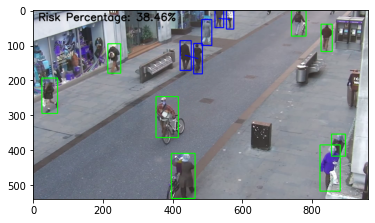

** Frame # 46 **

Person # 0, located: (379, 308) confidence: 75.18
Person # 1, located: (873, 387) confidence: 84.15
Person # 2, located: (42, 244) confidence: 87.43
Person # 3, located: (533, 24) confidence: 87.64
Person # 4, located: (234, 137) confidence: 90.04
Person # 5, located: (564, 27) confidence: 91.05
Person # 6, located: (850, 452) confidence: 92.91
Person # 7, located: (840, 78) confidence: 93.75
Person # 8, located: (501, 61) confidence: 94.97
Person # 9, located: (761, 37) confidence: 96.05
Person # 10, located: (438, 129) confidence: 96.09
Person # 11, located: (432, 473) confidence: 97.93
Person # 12, located: (473, 137) confidence: 97.97

Total number of people 13
Total number of people who break social distancing measure 5
People ids who break social distancing measure [3, 5, 8, 10, 12]



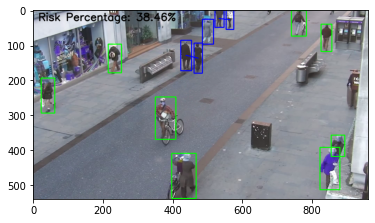

** Frame # 47 **

Person # 0, located: (677, 6) confidence: 57.86
Person # 1, located: (376, 316) confidence: 77.97
Person # 2, located: (38, 245) confidence: 79.08
Person # 3, located: (871, 388) confidence: 79.75
Person # 4, located: (534, 23) confidence: 86.22
Person # 5, located: (235, 138) confidence: 89.05
Person # 6, located: (840, 78) confidence: 91.79
Person # 7, located: (563, 26) confidence: 92.23
Person # 8, located: (850, 459) confidence: 92.51
Person # 9, located: (439, 128) confidence: 94.15
Person # 10, located: (761, 35) confidence: 95.49
Person # 11, located: (502, 61) confidence: 96.57
Person # 12, located: (474, 134) confidence: 98.31
Person # 13, located: (433, 472) confidence: 99.13

Total number of people 14
Total number of people who break social distancing measure 5
People ids who break social distancing measure [4, 7, 11, 9, 12]



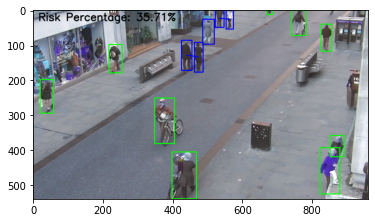

** Frame # 48 **

Person # 0, located: (677, 6) confidence: 53.54
Person # 1, located: (869, 390) confidence: 73.21
Person # 2, located: (33, 238) confidence: 75.74
Person # 3, located: (236, 136) confidence: 80.4
Person # 4, located: (535, 23) confidence: 84.43
Person # 5, located: (849, 461) confidence: 84.53
Person # 6, located: (562, 26) confidence: 89.51
Person # 7, located: (840, 78) confidence: 90.49
Person # 8, located: (374, 318) confidence: 91.88
Person # 9, located: (504, 61) confidence: 93.1
Person # 10, located: (762, 35) confidence: 95.2
Person # 11, located: (441, 126) confidence: 95.79
Person # 12, located: (474, 132) confidence: 98.69
Person # 13, located: (435, 467) confidence: 98.77

Total number of people 14
Total number of people who break social distancing measure 5
People ids who break social distancing measure [4, 6, 9, 11, 12]



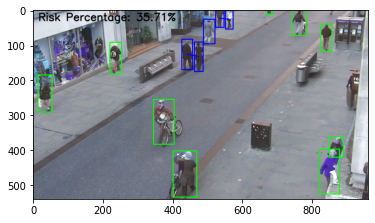

** Frame # 49 **

Person # 0, located: (677, 6) confidence: 60.35
Person # 1, located: (868, 393) confidence: 74.57
Person # 2, located: (535, 23) confidence: 79.51
Person # 3, located: (32, 244) confidence: 85.9
Person # 4, located: (848, 450) confidence: 87.85
Person # 5, located: (840, 77) confidence: 90.16
Person # 6, located: (238, 135) confidence: 90.62
Person # 7, located: (561, 27) confidence: 92.53
Person # 8, located: (762, 35) confidence: 94.95
Person # 9, located: (507, 60) confidence: 95.52
Person # 10, located: (373, 319) confidence: 95.59
Person # 11, located: (444, 126) confidence: 97.3
Person # 12, located: (476, 131) confidence: 98.91
Person # 13, located: (436, 466) confidence: 99.23

Total number of people 14
Total number of people who break social distancing measure 5
People ids who break social distancing measure [2, 7, 9, 11, 12]



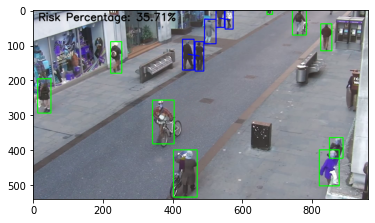

** Frame # 50 **

Person # 0, located: (677, 5) confidence: 62.04
Person # 1, located: (848, 451) confidence: 78.85
Person # 2, located: (536, 23) confidence: 80.21
Person # 3, located: (866, 395) confidence: 82.63
Person # 4, located: (370, 319) confidence: 85.09
Person # 5, located: (30, 246) confidence: 86.92
Person # 6, located: (840, 76) confidence: 90.26
Person # 7, located: (239, 133) confidence: 90.7
Person # 8, located: (560, 27) confidence: 92.04
Person # 9, located: (764, 33) confidence: 94.39
Person # 10, located: (446, 126) confidence: 96.1
Person # 11, located: (508, 60) confidence: 97.38
Person # 12, located: (438, 461) confidence: 97.82
Person # 13, located: (478, 131) confidence: 97.95

Total number of people 14
Total number of people who break social distancing measure 7
People ids who break social distancing measure [1, 3, 2, 8, 11, 10, 13]



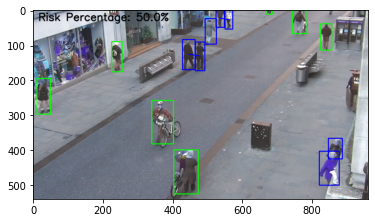

** Frame # 51 **

Person # 0, located: (677, 6) confidence: 63.87
Person # 1, located: (369, 320) confidence: 78.43
Person # 2, located: (865, 396) confidence: 78.99
Person # 3, located: (536, 23) confidence: 80.0
Person # 4, located: (848, 465) confidence: 82.05
Person # 5, located: (559, 27) confidence: 87.53
Person # 6, located: (27, 249) confidence: 91.43
Person # 7, located: (840, 74) confidence: 91.63
Person # 8, located: (764, 33) confidence: 94.21
Person # 9, located: (480, 131) confidence: 95.65
Person # 10, located: (242, 131) confidence: 96.02
Person # 11, located: (510, 60) confidence: 96.47
Person # 12, located: (447, 126) confidence: 96.65
Person # 13, located: (439, 460) confidence: 98.0

Total number of people 14
Total number of people who break social distancing measure 5
People ids who break social distancing measure [3, 5, 11, 9, 12]



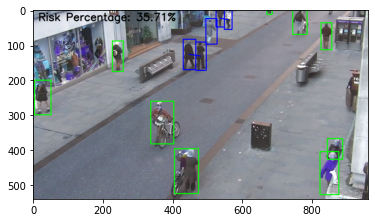

** Frame # 52 **

Person # 0, located: (370, 322) confidence: 52.48
Person # 1, located: (851, 6) confidence: 59.11
Person # 2, located: (677, 6) confidence: 63.74
Person # 3, located: (863, 399) confidence: 76.1
Person # 4, located: (557, 27) confidence: 80.8
Person # 5, located: (849, 465) confidence: 83.76
Person # 6, located: (536, 24) confidence: 85.21
Person # 7, located: (26, 249) confidence: 88.86
Person # 8, located: (840, 73) confidence: 92.69
Person # 9, located: (440, 457) confidence: 94.35
Person # 10, located: (767, 33) confidence: 94.52
Person # 11, located: (511, 60) confidence: 95.62
Person # 12, located: (244, 130) confidence: 96.04
Person # 13, located: (448, 126) confidence: 96.46
Person # 14, located: (482, 130) confidence: 96.98

Total number of people 15
Total number of people who break social distancing measure 5
People ids who break social distancing measure [4, 6, 11, 13, 14]



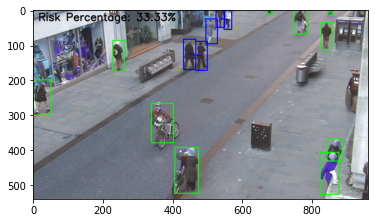

** Frame # 53 **

Person # 0, located: (677, 6) confidence: 59.56
Person # 1, located: (862, 400) confidence: 75.33
Person # 2, located: (850, 459) confidence: 77.02
Person # 3, located: (26, 249) confidence: 82.17
Person # 4, located: (557, 27) confidence: 82.69
Person # 5, located: (364, 318) confidence: 85.84
Person # 6, located: (536, 24) confidence: 87.27
Person # 7, located: (840, 73) confidence: 93.55
Person # 8, located: (767, 34) confidence: 95.3
Person # 9, located: (442, 452) confidence: 95.43
Person # 10, located: (245, 130) confidence: 96.22
Person # 11, located: (483, 130) confidence: 96.84
Person # 12, located: (449, 125) confidence: 96.94
Person # 13, located: (511, 60) confidence: 97.15

Total number of people 14
Total number of people who break social distancing measure 5
People ids who break social distancing measure [4, 6, 13, 11, 12]



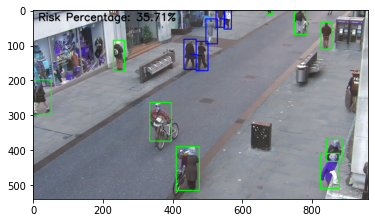

** Frame # 54 **

Person # 0, located: (677, 6) confidence: 56.33
Person # 1, located: (851, 459) confidence: 69.45
Person # 2, located: (556, 27) confidence: 70.85
Person # 3, located: (861, 400) confidence: 76.41
Person # 4, located: (25, 251) confidence: 78.94
Person # 5, located: (361, 316) confidence: 80.72
Person # 6, located: (536, 24) confidence: 87.41
Person # 7, located: (247, 129) confidence: 92.83
Person # 8, located: (768, 33) confidence: 94.78
Person # 9, located: (840, 72) confidence: 95.3
Person # 10, located: (443, 451) confidence: 95.69
Person # 11, located: (484, 130) confidence: 95.75
Person # 12, located: (512, 60) confidence: 97.12
Person # 13, located: (451, 124) confidence: 97.39

Total number of people 14
Total number of people who break social distancing measure 7
People ids who break social distancing measure [1, 3, 2, 6, 12, 11, 13]



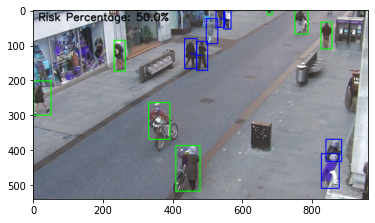

** Frame # 55 **

Person # 0, located: (860, 403) confidence: 53.79
Person # 1, located: (852, 459) confidence: 61.26
Person # 2, located: (554, 29) confidence: 62.16
Person # 3, located: (23, 253) confidence: 77.38
Person # 4, located: (359, 307) confidence: 79.52
Person # 5, located: (250, 129) confidence: 84.28
Person # 6, located: (536, 24) confidence: 86.91
Person # 7, located: (770, 33) confidence: 92.06
Person # 8, located: (840, 72) confidence: 92.75
Person # 9, located: (446, 450) confidence: 93.02
Person # 10, located: (484, 129) confidence: 95.85
Person # 11, located: (513, 60) confidence: 96.27
Person # 12, located: (452, 122) confidence: 97.05

Total number of people 13
Total number of people who break social distancing measure 7
People ids who break social distancing measure [0, 1, 2, 6, 11, 10, 12]



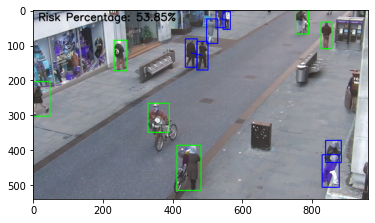

** Frame # 56 **

Person # 0, located: (677, 5) confidence: 64.29
Person # 1, located: (14, 251) confidence: 67.34
Person # 2, located: (554, 29) confidence: 72.98
Person # 3, located: (450, 450) confidence: 81.44
Person # 4, located: (358, 314) confidence: 82.82
Person # 5, located: (537, 24) confidence: 84.13
Person # 6, located: (853, 458) confidence: 84.33
Person # 7, located: (254, 129) confidence: 87.43
Person # 8, located: (840, 72) confidence: 87.84
Person # 9, located: (772, 32) confidence: 89.16
Person # 10, located: (487, 126) confidence: 94.13
Person # 11, located: (514, 60) confidence: 96.03
Person # 12, located: (455, 121) confidence: 96.88

Total number of people 13
Total number of people who break social distancing measure 5
People ids who break social distancing measure [2, 5, 11, 10, 12]



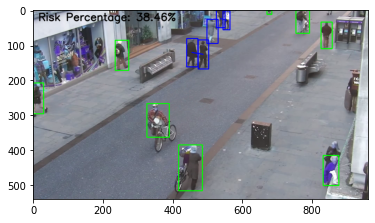

** Frame # 57 **

Person # 0, located: (14, 257) confidence: 59.48
Person # 1, located: (677, 5) confidence: 68.99
Person # 2, located: (840, 71) confidence: 71.75
Person # 3, located: (538, 24) confidence: 78.5
Person # 4, located: (358, 317) confidence: 82.11
Person # 5, located: (553, 29) confidence: 82.47
Person # 6, located: (853, 464) confidence: 86.74
Person # 7, located: (772, 33) confidence: 89.33
Person # 8, located: (255, 129) confidence: 89.65
Person # 9, located: (514, 59) confidence: 94.86
Person # 10, located: (452, 449) confidence: 95.59
Person # 11, located: (489, 126) confidence: 97.04
Person # 12, located: (457, 120) confidence: 99.05

Total number of people 13
Total number of people who break social distancing measure 5
People ids who break social distancing measure [3, 5, 9, 11, 12]



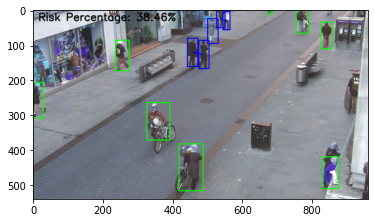

** Frame # 58 **

Person # 0, located: (11, 252) confidence: 58.84
Person # 1, located: (539, 24) confidence: 60.89
Person # 2, located: (678, 5) confidence: 72.14
Person # 3, located: (840, 71) confidence: 75.78
Person # 4, located: (853, 466) confidence: 79.05
Person # 5, located: (552, 29) confidence: 85.97
Person # 6, located: (352, 327) confidence: 86.5
Person # 7, located: (773, 33) confidence: 90.17
Person # 8, located: (256, 129) confidence: 92.66
Person # 9, located: (452, 447) confidence: 95.63
Person # 10, located: (515, 59) confidence: 96.91
Person # 11, located: (491, 126) confidence: 97.93
Person # 12, located: (458, 120) confidence: 98.44

Total number of people 13
Total number of people who break social distancing measure 5
People ids who break social distancing measure [1, 5, 10, 11, 12]



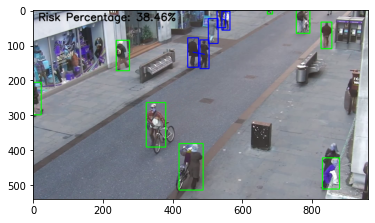

** Frame # 59 **

Person # 0, located: (852, 430) confidence: 57.81
Person # 1, located: (678, 5) confidence: 72.94
Person # 2, located: (851, 471) confidence: 75.09
Person # 3, located: (841, 70) confidence: 81.04
Person # 4, located: (773, 32) confidence: 91.59
Person # 5, located: (551, 29) confidence: 92.07
Person # 6, located: (257, 129) confidence: 94.45
Person # 7, located: (456, 446) confidence: 96.14
Person # 8, located: (516, 58) confidence: 96.21
Person # 9, located: (350, 332) confidence: 97.39
Person # 10, located: (459, 120) confidence: 97.72
Person # 11, located: (493, 125) confidence: 98.28

Total number of people 12
Total number of people who break social distancing measure 6
People ids who break social distancing measure [0, 2, 5, 8, 10, 11]



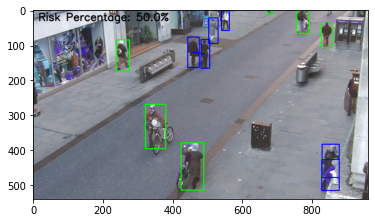

** Frame # 60 **

Person # 0, located: (6, 252) confidence: 50.03
Person # 1, located: (850, 433) confidence: 56.11
Person # 2, located: (852, 473) confidence: 67.32
Person # 3, located: (678, 4) confidence: 72.74
Person # 4, located: (841, 70) confidence: 85.22
Person # 5, located: (257, 129) confidence: 92.28
Person # 6, located: (773, 32) confidence: 92.29
Person # 7, located: (457, 440) confidence: 94.1
Person # 8, located: (549, 30) confidence: 94.66
Person # 9, located: (517, 57) confidence: 95.67
Person # 10, located: (460, 120) confidence: 97.15
Person # 11, located: (348, 335) confidence: 97.16
Person # 12, located: (494, 124) confidence: 98.03

Total number of people 13
Total number of people who break social distancing measure 6
People ids who break social distancing measure [1, 2, 8, 9, 10, 12]



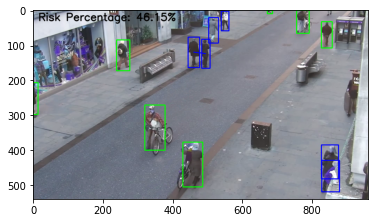

** Frame # 61 **

Person # 0, located: (678, 4) confidence: 74.89
Person # 1, located: (849, 458) confidence: 77.82
Person # 2, located: (259, 126) confidence: 79.79
Person # 3, located: (841, 70) confidence: 89.95
Person # 4, located: (773, 32) confidence: 92.22
Person # 5, located: (518, 58) confidence: 95.27
Person # 6, located: (549, 30) confidence: 96.18
Person # 7, located: (461, 120) confidence: 96.61
Person # 8, located: (347, 336) confidence: 97.06
Person # 9, located: (457, 436) confidence: 97.32
Person # 10, located: (495, 124) confidence: 97.52

Total number of people 11
Total number of people who break social distancing measure 4
People ids who break social distancing measure [5, 6, 7, 10]



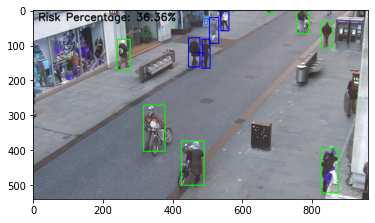

** Frame # 62 **

Person # 0, located: (678, 4) confidence: 72.74
Person # 1, located: (260, 125) confidence: 76.97
Person # 2, located: (847, 458) confidence: 86.04
Person # 3, located: (774, 32) confidence: 91.92
Person # 4, located: (841, 70) confidence: 94.48
Person # 5, located: (518, 58) confidence: 95.08
Person # 6, located: (343, 339) confidence: 95.51
Person # 7, located: (548, 30) confidence: 96.24
Person # 8, located: (496, 124) confidence: 97.33
Person # 9, located: (462, 120) confidence: 97.39
Person # 10, located: (459, 434) confidence: 98.19

Total number of people 11
Total number of people who break social distancing measure 4
People ids who break social distancing measure [5, 7, 8, 9]



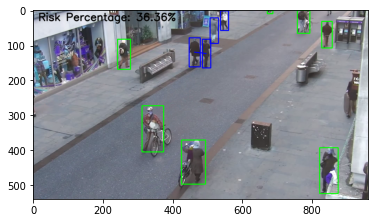

** Frame # 63 **

Person # 0, located: (679, 4) confidence: 70.5
Person # 1, located: (262, 124) confidence: 74.21
Person # 2, located: (518, 58) confidence: 87.33
Person # 3, located: (775, 31) confidence: 91.86
Person # 4, located: (845, 459) confidence: 92.53
Person # 5, located: (547, 30) confidence: 96.11
Person # 6, located: (497, 123) confidence: 97.18
Person # 7, located: (842, 69) confidence: 97.37
Person # 8, located: (464, 120) confidence: 97.7
Person # 9, located: (341, 344) confidence: 98.11
Person # 10, located: (461, 431) confidence: 98.76

Total number of people 11
Total number of people who break social distancing measure 4
People ids who break social distancing measure [2, 5, 6, 8]



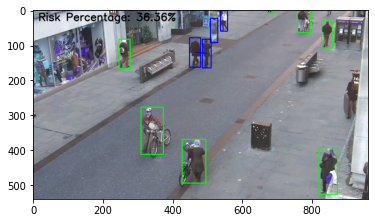

** Frame # 64 **

Person # 0, located: (679, 4) confidence: 67.25
Person # 1, located: (263, 124) confidence: 69.82
Person # 2, located: (519, 54) confidence: 90.11
Person # 3, located: (776, 30) confidence: 91.08
Person # 4, located: (843, 459) confidence: 92.04
Person # 5, located: (545, 30) confidence: 95.28
Person # 6, located: (338, 345) confidence: 96.22
Person # 7, located: (842, 68) confidence: 97.04
Person # 8, located: (462, 430) confidence: 98.05
Person # 9, located: (498, 124) confidence: 98.08
Person # 10, located: (465, 120) confidence: 98.5

Total number of people 11
Total number of people who break social distancing measure 4
People ids who break social distancing measure [2, 5, 9, 10]



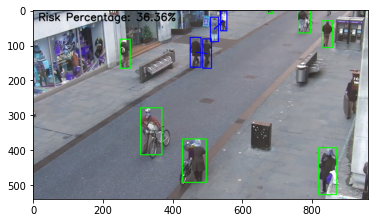

** Frame # 65 **

Person # 0, located: (264, 123) confidence: 55.68
Person # 1, located: (679, 4) confidence: 66.84
Person # 2, located: (777, 30) confidence: 86.85
Person # 3, located: (521, 54) confidence: 87.78
Person # 4, located: (545, 30) confidence: 88.55
Person # 5, located: (842, 459) confidence: 94.17
Person # 6, located: (842, 67) confidence: 96.33
Person # 7, located: (463, 428) confidence: 96.69
Person # 8, located: (499, 123) confidence: 97.83
Person # 9, located: (466, 120) confidence: 97.93
Person # 10, located: (337, 347) confidence: 98.24

Total number of people 11
Total number of people who break social distancing measure 4
People ids who break social distancing measure [3, 4, 8, 9]



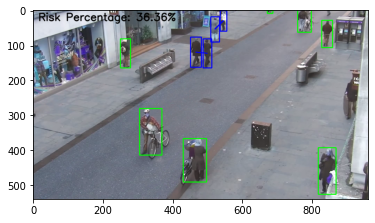

** Frame # 66 **

Person # 0, located: (265, 122) confidence: 60.31
Person # 1, located: (678, 4) confidence: 65.9
Person # 2, located: (522, 59) confidence: 76.45
Person # 3, located: (543, 31) confidence: 86.55
Person # 4, located: (777, 30) confidence: 89.44
Person # 5, located: (466, 427) confidence: 90.11
Person # 6, located: (841, 461) confidence: 93.96
Person # 7, located: (842, 67) confidence: 95.84
Person # 8, located: (500, 123) confidence: 98.07
Person # 9, located: (335, 348) confidence: 98.21
Person # 10, located: (468, 117) confidence: 98.26

Total number of people 11
Total number of people who break social distancing measure 4
People ids who break social distancing measure [2, 3, 8, 10]



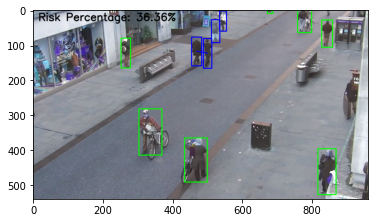

** Frame # 67 **

Person # 0, located: (678, 4) confidence: 60.33
Person # 1, located: (843, 8) confidence: 61.46
Person # 2, located: (523, 59) confidence: 68.76
Person # 3, located: (267, 122) confidence: 69.28
Person # 4, located: (542, 32) confidence: 82.44
Person # 5, located: (776, 30) confidence: 89.85
Person # 6, located: (467, 424) confidence: 93.26
Person # 7, located: (841, 462) confidence: 93.62
Person # 8, located: (842, 66) confidence: 94.86
Person # 9, located: (332, 348) confidence: 97.03
Person # 10, located: (470, 116) confidence: 98.42
Person # 11, located: (501, 122) confidence: 98.45

Total number of people 12
Total number of people who break social distancing measure 6
People ids who break social distancing measure [1, 8, 2, 4, 10, 11]



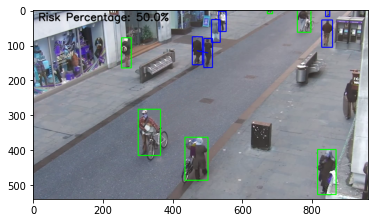

** Frame # 68 **

Person # 0, located: (678, 4) confidence: 59.69
Person # 1, located: (843, 9) confidence: 68.7
Person # 2, located: (524, 54) confidence: 69.48
Person # 3, located: (268, 121) confidence: 75.78
Person # 4, located: (542, 32) confidence: 82.48
Person # 5, located: (840, 465) confidence: 90.22
Person # 6, located: (775, 30) confidence: 92.35
Person # 7, located: (843, 65) confidence: 92.99
Person # 8, located: (331, 350) confidence: 95.59
Person # 9, located: (470, 424) confidence: 96.19
Person # 10, located: (471, 114) confidence: 96.93
Person # 11, located: (502, 120) confidence: 97.89

Total number of people 12
Total number of people who break social distancing measure 6
People ids who break social distancing measure [1, 7, 2, 4, 10, 11]



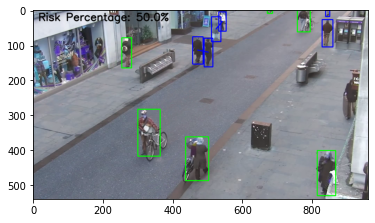

** Frame # 69 **

Person # 0, located: (678, 4) confidence: 58.36
Person # 1, located: (842, 8) confidence: 70.48
Person # 2, located: (525, 54) confidence: 74.46
Person # 3, located: (541, 32) confidence: 77.96
Person # 4, located: (840, 471) confidence: 88.06
Person # 5, located: (270, 121) confidence: 88.19
Person # 6, located: (843, 65) confidence: 93.37
Person # 7, located: (329, 352) confidence: 94.57
Person # 8, located: (775, 30) confidence: 95.63
Person # 9, located: (473, 114) confidence: 96.66
Person # 10, located: (471, 423) confidence: 97.39
Person # 11, located: (503, 119) confidence: 97.82

Total number of people 12
Total number of people who break social distancing measure 6
People ids who break social distancing measure [1, 6, 2, 3, 9, 11]



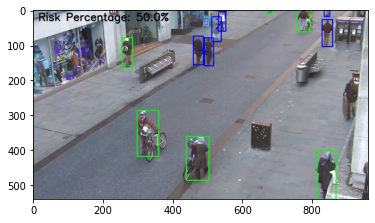

** Frame # 70 **

Person # 0, located: (841, 9) confidence: 54.59
Person # 1, located: (541, 32) confidence: 65.54
Person # 2, located: (526, 53) confidence: 72.56
Person # 3, located: (272, 122) confidence: 84.77
Person # 4, located: (840, 472) confidence: 90.02
Person # 5, located: (843, 65) confidence: 92.01
Person # 6, located: (325, 352) confidence: 93.75
Person # 7, located: (776, 30) confidence: 94.68
Person # 8, located: (506, 118) confidence: 94.95
Person # 9, located: (473, 112) confidence: 97.23
Person # 10, located: (473, 421) confidence: 98.2

Total number of people 11
Total number of people who break social distancing measure 6
People ids who break social distancing measure [0, 5, 1, 2, 8, 9]



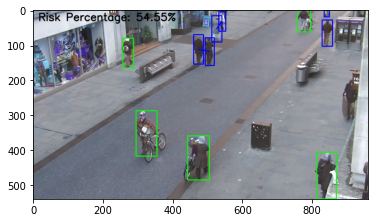

** Frame # 71 **

Person # 0, located: (527, 52) confidence: 79.47
Person # 1, located: (273, 124) confidence: 81.22
Person # 2, located: (777, 30) confidence: 91.22
Person # 3, located: (843, 65) confidence: 92.68
Person # 4, located: (839, 475) confidence: 93.64
Person # 5, located: (323, 353) confidence: 94.48
Person # 6, located: (476, 419) confidence: 96.74
Person # 7, located: (506, 117) confidence: 97.79
Person # 8, located: (475, 111) confidence: 98.01

Total number of people 9
Total number of people who break social distancing measure 2
People ids who break social distancing measure [7, 8]



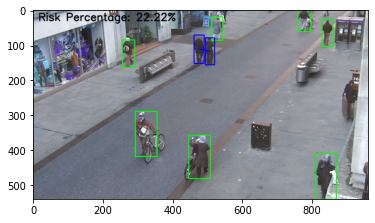

** Frame # 72 **

Person # 0, located: (679, 4) confidence: 53.12
Person # 1, located: (274, 121) confidence: 78.2
Person # 2, located: (776, 27) confidence: 87.42
Person # 3, located: (528, 53) confidence: 88.07
Person # 4, located: (321, 355) confidence: 88.63
Person # 5, located: (839, 476) confidence: 92.43
Person # 6, located: (843, 65) confidence: 92.68
Person # 7, located: (478, 414) confidence: 96.63
Person # 8, located: (508, 116) confidence: 97.22
Person # 9, located: (478, 111) confidence: 97.91

Total number of people 10
Total number of people who break social distancing measure 2
People ids who break social distancing measure [8, 9]



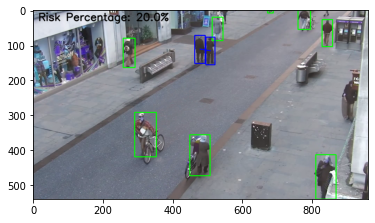

** Frame # 73 **

Person # 0, located: (679, 3) confidence: 51.65
Person # 1, located: (546, 19) confidence: 52.51
Person # 2, located: (840, 9) confidence: 65.55
Person # 3, located: (276, 123) confidence: 66.76
Person # 4, located: (777, 26) confidence: 87.19
Person # 5, located: (318, 362) confidence: 87.43
Person # 6, located: (529, 53) confidence: 89.93
Person # 7, located: (838, 478) confidence: 91.48
Person # 8, located: (843, 65) confidence: 92.81
Person # 9, located: (480, 412) confidence: 94.26
Person # 10, located: (479, 111) confidence: 95.89
Person # 11, located: (509, 115) confidence: 96.45

Total number of people 12
Total number of people who break social distancing measure 6
People ids who break social distancing measure [1, 6, 2, 8, 10, 11]



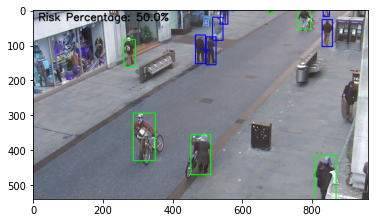

** Frame # 74 **

Person # 0, located: (547, 19) confidence: 55.8
Person # 1, located: (679, 3) confidence: 57.76
Person # 2, located: (276, 121) confidence: 58.47
Person # 3, located: (840, 9) confidence: 64.56
Person # 4, located: (905, 264) confidence: 72.12
Person # 5, located: (778, 26) confidence: 85.96
Person # 6, located: (531, 53) confidence: 92.12
Person # 7, located: (838, 478) confidence: 92.38
Person # 8, located: (843, 65) confidence: 93.35
Person # 9, located: (317, 365) confidence: 94.18
Person # 10, located: (511, 115) confidence: 95.67
Person # 11, located: (482, 409) confidence: 96.2
Person # 12, located: (482, 111) confidence: 97.51

Total number of people 13
Total number of people who break social distancing measure 6
People ids who break social distancing measure [0, 6, 3, 8, 10, 12]



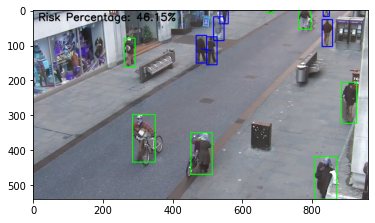

** Frame # 75 **

Person # 0, located: (679, 3) confidence: 58.61
Person # 1, located: (839, 9) confidence: 59.0
Person # 2, located: (548, 19) confidence: 72.58
Person # 3, located: (905, 266) confidence: 76.4
Person # 4, located: (779, 27) confidence: 92.42
Person # 5, located: (842, 65) confidence: 92.46
Person # 6, located: (837, 479) confidence: 93.29
Person # 7, located: (314, 366) confidence: 93.44
Person # 8, located: (513, 116) confidence: 94.9
Person # 9, located: (534, 51) confidence: 96.9
Person # 10, located: (482, 406) confidence: 97.18
Person # 11, located: (482, 111) confidence: 97.65

Total number of people 12
Total number of people who break social distancing measure 6
People ids who break social distancing measure [1, 5, 2, 9, 8, 11]



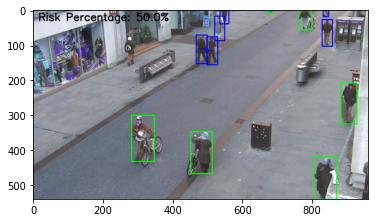

** Frame # 76 **

Person # 0, located: (679, 3) confidence: 53.31
Person # 1, located: (837, 9) confidence: 57.49
Person # 2, located: (549, 19) confidence: 71.13
Person # 3, located: (904, 267) confidence: 87.85
Person # 4, located: (781, 26) confidence: 89.28
Person # 5, located: (842, 63) confidence: 89.76
Person # 6, located: (837, 480) confidence: 91.43
Person # 7, located: (535, 49) confidence: 93.66
Person # 8, located: (513, 115) confidence: 94.97
Person # 9, located: (311, 367) confidence: 96.15
Person # 10, located: (484, 405) confidence: 96.38
Person # 11, located: (483, 111) confidence: 97.66

Total number of people 12
Total number of people who break social distancing measure 7
People ids who break social distancing measure [1, 4, 5, 2, 7, 8, 11]



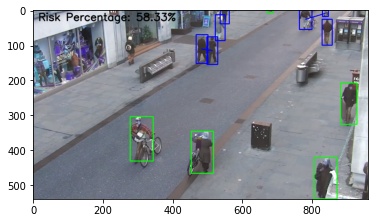

** Frame # 77 **

Person # 0, located: (836, 9) confidence: 60.5
Person # 1, located: (550, 19) confidence: 61.39
Person # 2, located: (836, 481) confidence: 79.95
Person # 3, located: (785, 26) confidence: 84.88
Person # 4, located: (537, 49) confidence: 90.59
Person # 5, located: (842, 61) confidence: 91.09
Person # 6, located: (309, 366) confidence: 91.98
Person # 7, located: (514, 114) confidence: 94.02
Person # 8, located: (905, 266) confidence: 96.08
Person # 9, located: (486, 405) confidence: 97.9
Person # 10, located: (485, 111) confidence: 98.04

Total number of people 11
Total number of people who break social distancing measure 7
People ids who break social distancing measure [0, 3, 5, 1, 4, 7, 10]



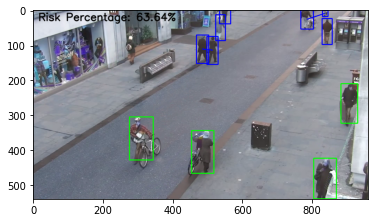

** Frame # 78 **

Person # 0, located: (835, 9) confidence: 51.91
Person # 1, located: (836, 481) confidence: 85.29
Person # 2, located: (537, 48) confidence: 86.48
Person # 3, located: (785, 26) confidence: 89.67
Person # 4, located: (308, 373) confidence: 91.67
Person # 5, located: (515, 111) confidence: 92.74
Person # 6, located: (842, 60) confidence: 93.89
Person # 7, located: (905, 266) confidence: 94.88
Person # 8, located: (487, 404) confidence: 96.93
Person # 9, located: (485, 110) confidence: 98.48

Total number of people 10
Total number of people who break social distancing measure 5
People ids who break social distancing measure [0, 3, 6, 5, 9]



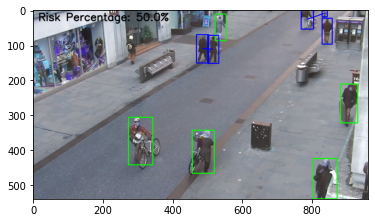

** Frame # 79 **

Person # 0, located: (551, 20) confidence: 52.27
Person # 1, located: (537, 47) confidence: 81.23
Person # 2, located: (834, 484) confidence: 83.8
Person # 3, located: (306, 365) confidence: 85.42
Person # 4, located: (786, 26) confidence: 91.46
Person # 5, located: (842, 59) confidence: 94.14
Person # 6, located: (904, 271) confidence: 95.08
Person # 7, located: (517, 112) confidence: 95.16
Person # 8, located: (488, 403) confidence: 97.35
Person # 9, located: (487, 109) confidence: 98.72

Total number of people 10
Total number of people who break social distancing measure 4
People ids who break social distancing measure [0, 1, 7, 9]



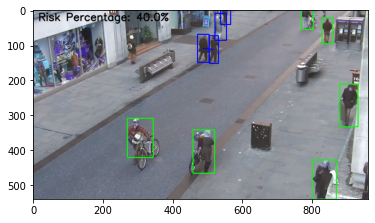

** Frame # 80 **

Person # 0, located: (551, 19) confidence: 61.52
Person # 1, located: (304, 366) confidence: 81.42
Person # 2, located: (537, 52) confidence: 85.87
Person # 3, located: (833, 485) confidence: 87.61
Person # 4, located: (786, 26) confidence: 90.39
Person # 5, located: (843, 58) confidence: 94.06
Person # 6, located: (904, 272) confidence: 95.96
Person # 7, located: (519, 111) confidence: 97.13
Person # 8, located: (489, 402) confidence: 97.55
Person # 9, located: (489, 107) confidence: 98.68

Total number of people 10
Total number of people who break social distancing measure 4
People ids who break social distancing measure [0, 2, 7, 9]



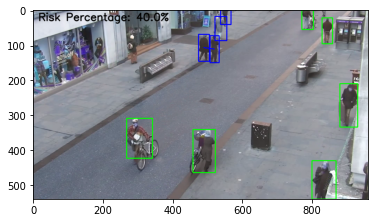

** Frame # 81 **

Person # 0, located: (551, 19) confidence: 65.65
Person # 1, located: (537, 50) confidence: 87.54
Person # 2, located: (300, 364) confidence: 88.28
Person # 3, located: (786, 26) confidence: 91.99
Person # 4, located: (832, 487) confidence: 92.11
Person # 5, located: (843, 58) confidence: 94.49
Person # 6, located: (491, 400) confidence: 96.09
Person # 7, located: (903, 272) confidence: 96.12
Person # 8, located: (521, 111) confidence: 97.81
Person # 9, located: (490, 106) confidence: 98.7

Total number of people 10
Total number of people who break social distancing measure 4
People ids who break social distancing measure [0, 1, 8, 9]



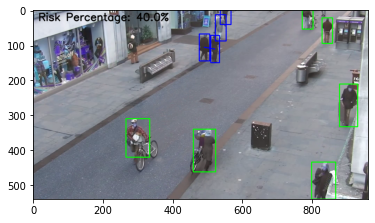

** Frame # 82 **

Person # 0, located: (551, 20) confidence: 62.87
Person # 1, located: (539, 50) confidence: 91.52
Person # 2, located: (787, 25) confidence: 91.98
Person # 3, located: (829, 488) confidence: 92.27
Person # 4, located: (843, 58) confidence: 92.48
Person # 5, located: (297, 373) confidence: 93.19
Person # 6, located: (492, 395) confidence: 94.93
Person # 7, located: (522, 110) confidence: 97.63
Person # 8, located: (902, 272) confidence: 97.79
Person # 9, located: (492, 105) confidence: 98.6

Total number of people 10
Total number of people who break social distancing measure 4
People ids who break social distancing measure [0, 1, 7, 9]



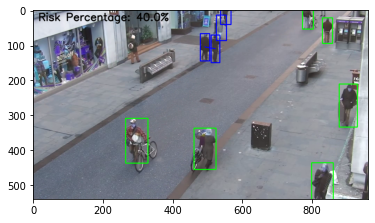

** Frame # 83 **

Person # 0, located: (551, 19) confidence: 68.09
Person # 1, located: (830, 9) confidence: 76.13
Person # 2, located: (788, 25) confidence: 83.92
Person # 3, located: (843, 58) confidence: 87.9
Person # 4, located: (829, 490) confidence: 91.54
Person # 5, located: (540, 49) confidence: 92.98
Person # 6, located: (295, 376) confidence: 96.92
Person # 7, located: (902, 273) confidence: 98.04
Person # 8, located: (493, 394) confidence: 98.15
Person # 9, located: (524, 110) confidence: 98.31
Person # 10, located: (493, 105) confidence: 98.84

Total number of people 11
Total number of people who break social distancing measure 7
People ids who break social distancing measure [0, 5, 1, 2, 3, 9, 10]



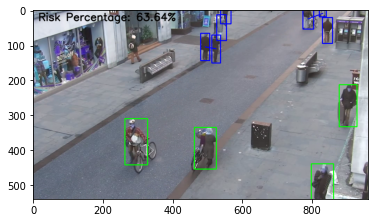

** Frame # 84 **

Person # 0, located: (551, 18) confidence: 64.43
Person # 1, located: (830, 9) confidence: 72.58
Person # 2, located: (788, 23) confidence: 85.23
Person # 3, located: (843, 58) confidence: 87.96
Person # 4, located: (540, 49) confidence: 92.49
Person # 5, located: (827, 490) confidence: 92.58
Person # 6, located: (292, 379) confidence: 97.5
Person # 7, located: (494, 391) confidence: 98.07
Person # 8, located: (525, 110) confidence: 98.13
Person # 9, located: (902, 274) confidence: 98.34
Person # 10, located: (494, 104) confidence: 98.47

Total number of people 11
Total number of people who break social distancing measure 7
People ids who break social distancing measure [0, 4, 1, 2, 3, 8, 10]



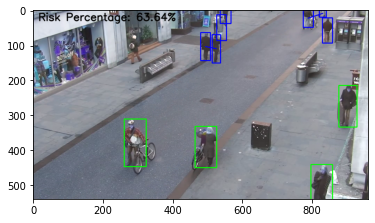

** Frame # 85 **

Person # 0, located: (552, 18) confidence: 54.03
Person # 1, located: (522, 38) confidence: 64.43
Person # 2, located: (829, 9) confidence: 65.33
Person # 3, located: (789, 23) confidence: 74.29
Person # 4, located: (844, 58) confidence: 84.92
Person # 5, located: (541, 49) confidence: 87.24
Person # 6, located: (825, 491) confidence: 92.09
Person # 7, located: (290, 385) confidence: 97.06
Person # 8, located: (499, 388) confidence: 97.44
Person # 9, located: (901, 276) confidence: 98.06
Person # 10, located: (526, 110) confidence: 98.32
Person # 11, located: (495, 103) confidence: 98.39

Total number of people 12
Total number of people who break social distancing measure 8
People ids who break social distancing measure [0, 1, 5, 2, 3, 4, 10, 11]



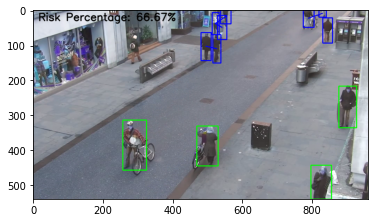

** Frame # 86 **

Person # 0, located: (522, 38) confidence: 74.96
Person # 1, located: (541, 48) confidence: 85.23
Person # 2, located: (844, 58) confidence: 85.34
Person # 3, located: (790, 24) confidence: 85.65
Person # 4, located: (825, 492) confidence: 92.51
Person # 5, located: (501, 387) confidence: 95.11
Person # 6, located: (901, 277) confidence: 97.61
Person # 7, located: (526, 110) confidence: 97.73
Person # 8, located: (497, 103) confidence: 97.95
Person # 9, located: (285, 391) confidence: 98.46

Total number of people 10
Total number of people who break social distancing measure 4
People ids who break social distancing measure [0, 1, 7, 8]



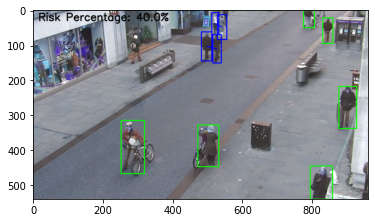

** Frame # 87 **

Person # 0, located: (828, 10) confidence: 60.81
Person # 1, located: (520, 38) confidence: 83.95
Person # 2, located: (844, 58) confidence: 84.68
Person # 3, located: (541, 46) confidence: 86.27
Person # 4, located: (790, 24) confidence: 92.98
Person # 5, located: (824, 494) confidence: 93.62
Person # 6, located: (503, 385) confidence: 94.72
Person # 7, located: (900, 279) confidence: 94.8
Person # 8, located: (527, 109) confidence: 97.12
Person # 9, located: (498, 103) confidence: 97.77
Person # 10, located: (283, 390) confidence: 98.95

Total number of people 11
Total number of people who break social distancing measure 7
People ids who break social distancing measure [0, 2, 4, 1, 3, 8, 9]



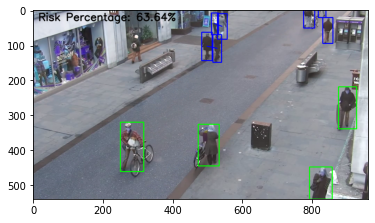

** Frame # 88 **

Person # 0, located: (297, 110) confidence: 76.53
Person # 1, located: (845, 57) confidence: 85.27
Person # 2, located: (519, 38) confidence: 86.16
Person # 3, located: (507, 384) confidence: 86.25
Person # 4, located: (791, 23) confidence: 88.4
Person # 5, located: (542, 46) confidence: 92.12
Person # 6, located: (822, 494) confidence: 94.21
Person # 7, located: (900, 280) confidence: 95.15
Person # 8, located: (282, 393) confidence: 96.44
Person # 9, located: (528, 109) confidence: 96.8
Person # 10, located: (499, 103) confidence: 98.76

Total number of people 11
Total number of people who break social distancing measure 4
People ids who break social distancing measure [2, 5, 9, 10]



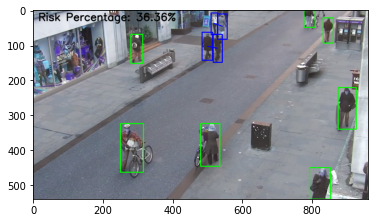

** Frame # 89 **

Person # 0, located: (553, 17) confidence: 50.33
Person # 1, located: (827, 10) confidence: 52.37
Person # 2, located: (845, 57) confidence: 72.3
Person # 3, located: (296, 109) confidence: 72.65
Person # 4, located: (793, 23) confidence: 83.06
Person # 5, located: (531, 107) confidence: 91.5
Person # 6, located: (821, 496) confidence: 92.81
Person # 7, located: (519, 40) confidence: 92.84
Person # 8, located: (507, 382) confidence: 93.51
Person # 9, located: (897, 281) confidence: 93.83
Person # 10, located: (542, 46) confidence: 94.91
Person # 11, located: (281, 395) confidence: 97.45
Person # 12, located: (500, 103) confidence: 98.76

Total number of people 13
Total number of people who break social distancing measure 8
People ids who break social distancing measure [0, 7, 10, 1, 2, 4, 5, 12]



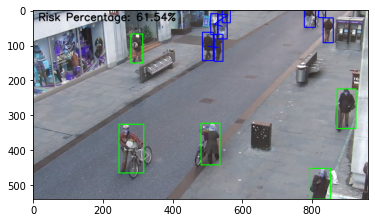

** Frame # 90 **

Person # 0, located: (553, 17) confidence: 63.23
Person # 1, located: (299, 109) confidence: 70.82
Person # 2, located: (845, 55) confidence: 74.24
Person # 3, located: (793, 24) confidence: 83.71
Person # 4, located: (820, 496) confidence: 87.18
Person # 5, located: (519, 40) confidence: 92.53
Person # 6, located: (896, 281) confidence: 93.89
Person # 7, located: (279, 402) confidence: 93.99
Person # 8, located: (542, 45) confidence: 94.41
Person # 9, located: (508, 382) confidence: 95.61
Person # 10, located: (532, 106) confidence: 95.91
Person # 11, located: (501, 103) confidence: 98.46

Total number of people 12
Total number of people who break social distancing measure 5
People ids who break social distancing measure [0, 5, 8, 10, 11]



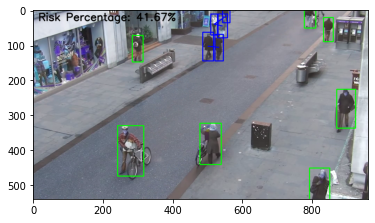

** Frame # 91 **

Person # 0, located: (301, 109) confidence: 70.8
Person # 1, located: (846, 54) confidence: 81.76
Person # 2, located: (793, 25) confidence: 84.66
Person # 3, located: (276, 401) confidence: 92.02
Person # 4, located: (819, 499) confidence: 92.32
Person # 5, located: (518, 40) confidence: 93.42
Person # 6, located: (895, 281) confidence: 94.09
Person # 7, located: (542, 45) confidence: 95.48
Person # 8, located: (533, 106) confidence: 97.48
Person # 9, located: (502, 103) confidence: 97.73
Person # 10, located: (509, 382) confidence: 99.15

Total number of people 11
Total number of people who break social distancing measure 4
People ids who break social distancing measure [5, 7, 8, 9]



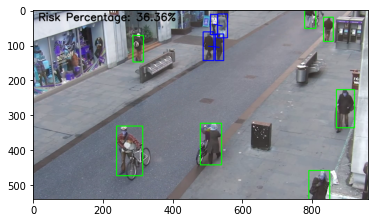

** Frame # 92 **

Person # 0, located: (304, 108) confidence: 62.4
Person # 1, located: (846, 53) confidence: 81.42
Person # 2, located: (793, 26) confidence: 82.39
Person # 3, located: (517, 41) confidence: 88.06
Person # 4, located: (892, 282) confidence: 92.04
Person # 5, located: (818, 501) confidence: 92.55
Person # 6, located: (272, 400) confidence: 93.72
Person # 7, located: (542, 44) confidence: 94.19
Person # 8, located: (503, 101) confidence: 97.01
Person # 9, located: (534, 104) confidence: 97.61
Person # 10, located: (511, 380) confidence: 98.45

Total number of people 11
Total number of people who break social distancing measure 6
People ids who break social distancing measure [1, 2, 3, 7, 8, 9]



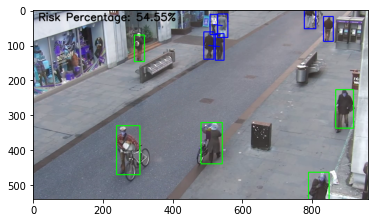

** Frame # 93 **

Person # 0, located: (304, 106) confidence: 77.35
Person # 1, located: (794, 25) confidence: 84.05
Person # 2, located: (846, 53) confidence: 86.06
Person # 3, located: (517, 41) confidence: 87.67
Person # 4, located: (504, 100) confidence: 88.08
Person # 5, located: (818, 502) confidence: 89.47
Person # 6, located: (891, 282) confidence: 92.75
Person # 7, located: (270, 400) confidence: 94.37
Person # 8, located: (543, 43) confidence: 94.37
Person # 9, located: (513, 377) confidence: 96.9
Person # 10, located: (535, 103) confidence: 97.54

Total number of people 11
Total number of people who break social distancing measure 6
People ids who break social distancing measure [1, 2, 3, 8, 4, 10]



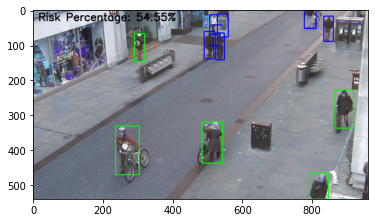

** Frame # 94 **

Person # 0, located: (793, 25) confidence: 77.83
Person # 1, located: (305, 106) confidence: 79.63
Person # 2, located: (846, 52) confidence: 81.55
Person # 3, located: (821, 505) confidence: 85.65
Person # 4, located: (516, 41) confidence: 92.7
Person # 5, located: (544, 43) confidence: 92.76
Person # 6, located: (890, 282) confidence: 92.86
Person # 7, located: (506, 98) confidence: 93.52
Person # 8, located: (266, 404) confidence: 95.29
Person # 9, located: (537, 102) confidence: 96.68
Person # 10, located: (514, 373) confidence: 97.54

Total number of people 11
Total number of people who break social distancing measure 6
People ids who break social distancing measure [0, 2, 4, 5, 7, 9]



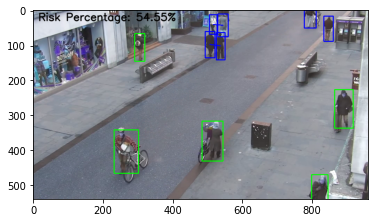

** Frame # 95 **

Person # 0, located: (550, 16) confidence: 52.38
Person # 1, located: (794, 25) confidence: 77.56
Person # 2, located: (846, 53) confidence: 81.65
Person # 3, located: (305, 106) confidence: 83.24
Person # 4, located: (819, 506) confidence: 89.24
Person # 5, located: (544, 43) confidence: 90.82
Person # 6, located: (265, 405) confidence: 92.15
Person # 7, located: (515, 40) confidence: 92.44
Person # 8, located: (540, 102) confidence: 95.56
Person # 9, located: (507, 97) confidence: 95.68
Person # 10, located: (888, 286) confidence: 96.41
Person # 11, located: (516, 371) confidence: 96.71

Total number of people 12
Total number of people who break social distancing measure 7
People ids who break social distancing measure [0, 5, 7, 1, 2, 8, 9]



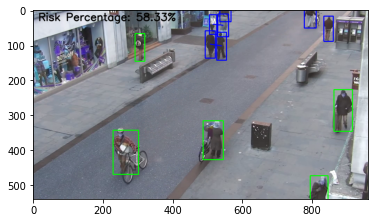

** Frame # 96 **

Person # 0, located: (550, 16) confidence: 51.45
Person # 1, located: (796, 25) confidence: 80.24
Person # 2, located: (846, 53) confidence: 80.7
Person # 3, located: (514, 40) confidence: 80.71
Person # 4, located: (307, 107) confidence: 81.28
Person # 5, located: (546, 41) confidence: 85.03
Person # 6, located: (261, 402) confidence: 91.05
Person # 7, located: (817, 507) confidence: 92.2
Person # 8, located: (509, 97) confidence: 96.06
Person # 9, located: (516, 367) confidence: 96.44
Person # 10, located: (888, 289) confidence: 97.09
Person # 11, located: (541, 102) confidence: 97.12

Total number of people 12
Total number of people who break social distancing measure 7
People ids who break social distancing measure [0, 3, 5, 1, 2, 8, 11]



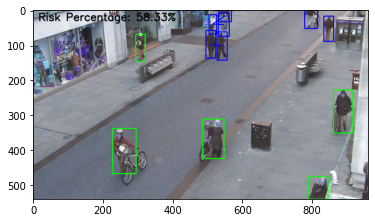

** Frame # 97 **

Person # 0, located: (846, 52) confidence: 83.34
Person # 1, located: (308, 107) confidence: 84.11
Person # 2, located: (513, 39) confidence: 85.76
Person # 3, located: (799, 24) confidence: 85.77
Person # 4, located: (547, 40) confidence: 87.3
Person # 5, located: (817, 509) confidence: 90.45
Person # 6, located: (258, 409) confidence: 91.43
Person # 7, located: (510, 96) confidence: 94.39
Person # 8, located: (518, 366) confidence: 96.74
Person # 9, located: (541, 102) confidence: 97.37
Person # 10, located: (887, 291) confidence: 98.28

Total number of people 11
Total number of people who break social distancing measure 6
People ids who break social distancing measure [0, 3, 2, 4, 7, 9]



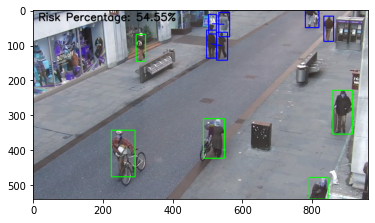

** Frame # 98 **

Person # 0, located: (800, 23) confidence: 74.21
Person # 1, located: (309, 106) confidence: 79.43
Person # 2, located: (846, 53) confidence: 81.54
Person # 3, located: (548, 40) confidence: 81.68
Person # 4, located: (512, 39) confidence: 86.51
Person # 5, located: (817, 509) confidence: 89.49
Person # 6, located: (257, 416) confidence: 90.65
Person # 7, located: (511, 96) confidence: 93.16
Person # 8, located: (519, 366) confidence: 96.78
Person # 9, located: (541, 103) confidence: 97.17
Person # 10, located: (885, 294) confidence: 97.74

Total number of people 11
Total number of people who break social distancing measure 6
People ids who break social distancing measure [0, 2, 3, 4, 7, 9]



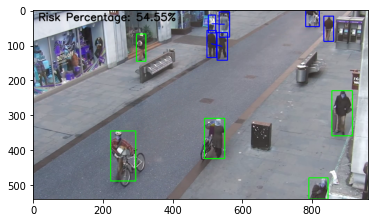

** Frame # 99 **

Person # 0, located: (800, 22) confidence: 66.79
Person # 1, located: (819, 510) confidence: 81.93
Person # 2, located: (550, 41) confidence: 82.46
Person # 3, located: (846, 52) confidence: 83.51
Person # 4, located: (311, 106) confidence: 84.68
Person # 5, located: (511, 39) confidence: 88.91
Person # 6, located: (513, 96) confidence: 94.1
Person # 7, located: (255, 421) confidence: 94.29
Person # 8, located: (884, 297) confidence: 96.28
Person # 9, located: (520, 365) confidence: 96.75
Person # 10, located: (543, 101) confidence: 96.99

Total number of people 11
Total number of people who break social distancing measure 6
People ids who break social distancing measure [0, 3, 2, 5, 6, 10]



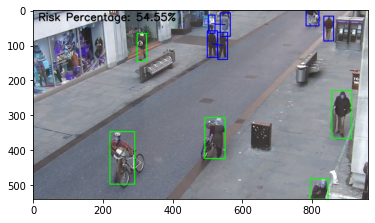

** Frame # 100 **

Person # 0, located: (801, 22) confidence: 62.34
Person # 1, located: (312, 105) confidence: 76.67
Person # 2, located: (256, 422) confidence: 80.3
Person # 3, located: (817, 512) confidence: 80.52
Person # 4, located: (550, 40) confidence: 85.38
Person # 5, located: (510, 43) confidence: 85.41
Person # 6, located: (847, 52) confidence: 87.86
Person # 7, located: (515, 97) confidence: 94.8
Person # 8, located: (883, 299) confidence: 95.25
Person # 9, located: (544, 100) confidence: 96.1
Person # 10, located: (523, 365) confidence: 97.16

Total number of people 11
Total number of people who break social distancing measure 6
People ids who break social distancing measure [0, 6, 4, 5, 7, 9]



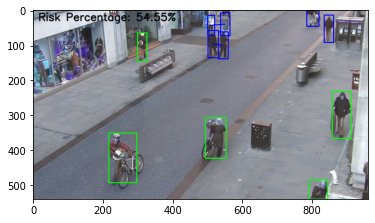

** Frame # 101 **

Person # 0, located: (803, 23) confidence: 62.92
Person # 1, located: (314, 105) confidence: 71.89
Person # 2, located: (818, 512) confidence: 86.28
Person # 3, located: (551, 40) confidence: 86.34
Person # 4, located: (249, 429) confidence: 88.76
Person # 5, located: (508, 43) confidence: 89.24
Person # 6, located: (847, 51) confidence: 91.91
Person # 7, located: (546, 100) confidence: 95.73
Person # 8, located: (516, 97) confidence: 96.62
Person # 9, located: (524, 364) confidence: 97.86
Person # 10, located: (882, 302) confidence: 98.07

Total number of people 11
Total number of people who break social distancing measure 6
People ids who break social distancing measure [0, 6, 3, 5, 8, 7]



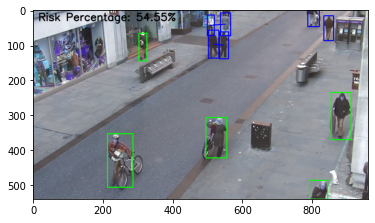

** Frame # 102 **

Person # 0, located: (803, 23) confidence: 72.39
Person # 1, located: (315, 102) confidence: 81.66
Person # 2, located: (818, 514) confidence: 83.05
Person # 3, located: (244, 430) confidence: 88.84
Person # 4, located: (506, 44) confidence: 90.16
Person # 5, located: (553, 39) confidence: 91.46
Person # 6, located: (847, 50) confidence: 92.96
Person # 7, located: (526, 363) confidence: 95.46
Person # 8, located: (548, 98) confidence: 96.03
Person # 9, located: (516, 96) confidence: 96.89
Person # 10, located: (881, 304) confidence: 98.86

Total number of people 11
Total number of people who break social distancing measure 6
People ids who break social distancing measure [0, 6, 4, 5, 9, 8]



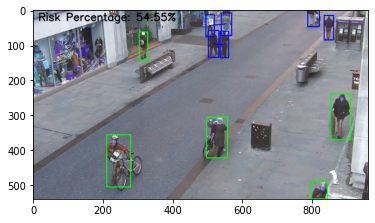

** Frame # 103 **

Person # 0, located: (802, 22) confidence: 75.51
Person # 1, located: (316, 101) confidence: 78.31
Person # 2, located: (506, 46) confidence: 82.83
Person # 3, located: (243, 430) confidence: 83.43
Person # 4, located: (821, 516) confidence: 86.22
Person # 5, located: (554, 39) confidence: 88.32
Person # 6, located: (527, 361) confidence: 88.54
Person # 7, located: (847, 48) confidence: 92.85
Person # 8, located: (549, 98) confidence: 95.27
Person # 9, located: (517, 96) confidence: 97.12
Person # 10, located: (880, 307) confidence: 98.64

Total number of people 11
Total number of people who break social distancing measure 6
People ids who break social distancing measure [0, 7, 2, 5, 9, 8]



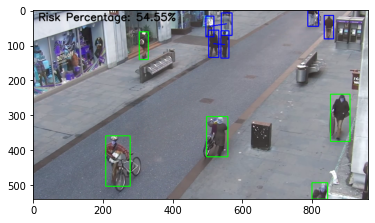

** Frame # 104 **

Person # 0, located: (822, 518) confidence: 63.26
Person # 1, located: (319, 100) confidence: 66.76
Person # 2, located: (803, 22) confidence: 76.97
Person # 3, located: (504, 47) confidence: 79.44
Person # 4, located: (237, 434) confidence: 89.29
Person # 5, located: (557, 39) confidence: 91.01
Person # 6, located: (848, 47) confidence: 94.29
Person # 7, located: (529, 358) confidence: 95.59
Person # 8, located: (550, 97) confidence: 95.66
Person # 9, located: (517, 95) confidence: 96.99
Person # 10, located: (879, 308) confidence: 98.76

Total number of people 11
Total number of people who break social distancing measure 6
People ids who break social distancing measure [2, 6, 3, 5, 9, 8]



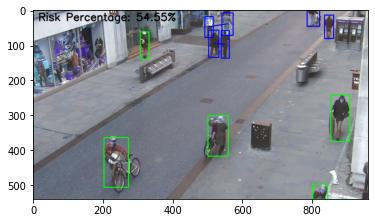

** Frame # 105 **

Person # 0, located: (821, 520) confidence: 63.44
Person # 1, located: (802, 22) confidence: 72.23
Person # 2, located: (235, 419) confidence: 78.07
Person # 3, located: (320, 97) confidence: 81.84
Person # 4, located: (503, 48) confidence: 89.03
Person # 5, located: (848, 47) confidence: 92.54
Person # 6, located: (557, 39) confidence: 94.19
Person # 7, located: (530, 356) confidence: 96.98
Person # 8, located: (551, 97) confidence: 97.23
Person # 9, located: (519, 92) confidence: 97.58
Person # 10, located: (879, 309) confidence: 98.69

Total number of people 11
Total number of people who break social distancing measure 6
People ids who break social distancing measure [1, 5, 4, 6, 9, 8]



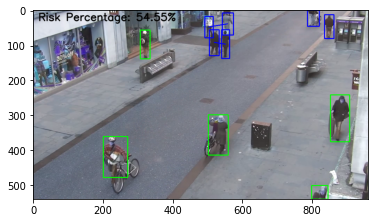

** Frame # 106 **

Person # 0, located: (819, 521) confidence: 56.65
Person # 1, located: (322, 97) confidence: 72.49
Person # 2, located: (803, 22) confidence: 73.33
Person # 3, located: (233, 416) confidence: 74.91
Person # 4, located: (503, 48) confidence: 88.01
Person # 5, located: (848, 47) confidence: 91.66
Person # 6, located: (558, 39) confidence: 95.05
Person # 7, located: (552, 96) confidence: 97.12
Person # 8, located: (531, 352) confidence: 97.28
Person # 9, located: (520, 91) confidence: 97.86
Person # 10, located: (878, 310) confidence: 98.33

Total number of people 11
Total number of people who break social distancing measure 6
People ids who break social distancing measure [2, 5, 4, 6, 9, 7]



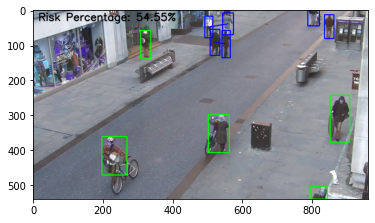

** Frame # 107 **

Person # 0, located: (323, 102) confidence: 52.89
Person # 1, located: (804, 22) confidence: 78.13
Person # 2, located: (848, 46) confidence: 90.29
Person # 3, located: (230, 421) confidence: 91.28
Person # 4, located: (502, 47) confidence: 91.62
Person # 5, located: (559, 38) confidence: 95.35
Person # 6, located: (878, 310) confidence: 98.02
Person # 7, located: (554, 97) confidence: 98.1
Person # 8, located: (522, 91) confidence: 98.1
Person # 9, located: (532, 350) confidence: 98.78

Total number of people 10
Total number of people who break social distancing measure 6
People ids who break social distancing measure [1, 2, 4, 5, 8, 7]



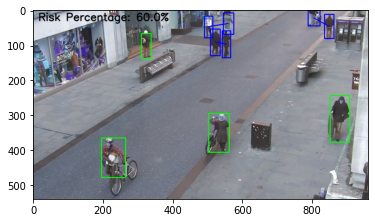

** Frame # 108 **

Person # 0, located: (326, 101) confidence: 51.16
Person # 1, located: (805, 22) confidence: 79.43
Person # 2, located: (848, 46) confidence: 91.14
Person # 3, located: (560, 37) confidence: 91.98
Person # 4, located: (502, 47) confidence: 92.57
Person # 5, located: (230, 434) confidence: 95.59
Person # 6, located: (554, 97) confidence: 97.05
Person # 7, located: (878, 310) confidence: 97.74
Person # 8, located: (523, 90) confidence: 98.54
Person # 9, located: (534, 348) confidence: 98.75

Total number of people 10
Total number of people who break social distancing measure 6
People ids who break social distancing measure [1, 2, 3, 4, 8, 6]



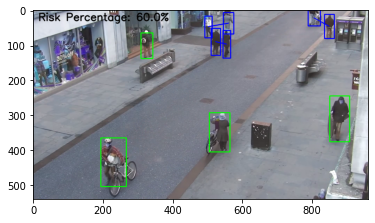

** Frame # 109 **

Person # 0, located: (805, 21) confidence: 73.2
Person # 1, located: (560, 37) confidence: 89.15
Person # 2, located: (848, 46) confidence: 89.46
Person # 3, located: (556, 96) confidence: 92.39
Person # 4, located: (501, 48) confidence: 93.4
Person # 5, located: (226, 437) confidence: 97.31
Person # 6, located: (878, 310) confidence: 97.79
Person # 7, located: (524, 89) confidence: 98.23
Person # 8, located: (536, 348) confidence: 98.79

Total number of people 9
Total number of people who break social distancing measure 6
People ids who break social distancing measure [0, 2, 1, 3, 7, 4]



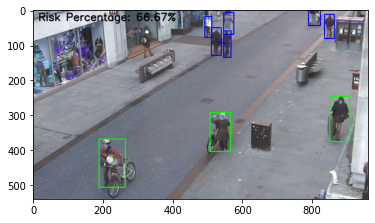

** Frame # 110 **

Person # 0, located: (330, 97) confidence: 72.58
Person # 1, located: (806, 21) confidence: 73.4
Person # 2, located: (560, 36) confidence: 87.26
Person # 3, located: (849, 46) confidence: 88.26
Person # 4, located: (500, 47) confidence: 94.81
Person # 5, located: (223, 447) confidence: 96.94
Person # 6, located: (877, 310) confidence: 97.07
Person # 7, located: (557, 95) confidence: 97.22
Person # 8, located: (525, 88) confidence: 98.37
Person # 9, located: (538, 347) confidence: 98.39

Total number of people 10
Total number of people who break social distancing measure 6
People ids who break social distancing measure [1, 3, 2, 7, 4, 8]



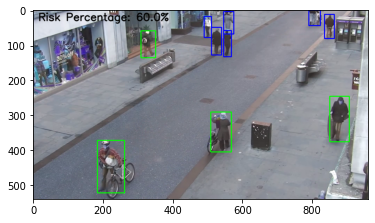

** Frame # 111 **

Person # 0, located: (807, 21) confidence: 67.91
Person # 1, located: (330, 97) confidence: 75.24
Person # 2, located: (849, 46) confidence: 88.76
Person # 3, located: (561, 35) confidence: 89.07
Person # 4, located: (876, 311) confidence: 94.31
Person # 5, located: (500, 47) confidence: 96.07
Person # 6, located: (218, 449) confidence: 97.31
Person # 7, located: (558, 94) confidence: 97.9
Person # 8, located: (526, 89) confidence: 97.91
Person # 9, located: (539, 346) confidence: 98.29

Total number of people 10
Total number of people who break social distancing measure 6
People ids who break social distancing measure [0, 2, 3, 7, 5, 8]



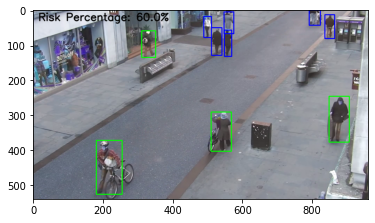

** Frame # 112 **

Person # 0, located: (806, 20) confidence: 51.64
Person # 1, located: (331, 96) confidence: 72.28
Person # 2, located: (850, 46) confidence: 86.64
Person # 3, located: (561, 33) confidence: 89.21
Person # 4, located: (499, 48) confidence: 94.89
Person # 5, located: (876, 314) confidence: 97.38
Person # 6, located: (527, 88) confidence: 97.85
Person # 7, located: (212, 452) confidence: 97.89
Person # 8, located: (541, 346) confidence: 98.13
Person # 9, located: (559, 93) confidence: 98.62

Total number of people 10
Total number of people who break social distancing measure 5
People ids who break social distancing measure [0, 2, 4, 6, 9]



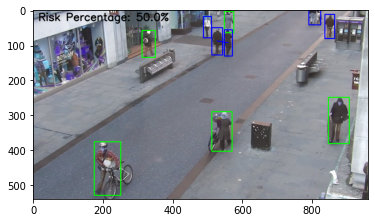

** Frame # 113 **

Person # 0, located: (332, 96) confidence: 65.55
Person # 1, located: (850, 46) confidence: 86.06
Person # 2, located: (562, 33) confidence: 91.19
Person # 3, located: (210, 456) confidence: 94.52
Person # 4, located: (543, 346) confidence: 95.27
Person # 5, located: (498, 49) confidence: 96.43
Person # 6, located: (528, 88) confidence: 97.95
Person # 7, located: (875, 317) confidence: 98.13
Person # 8, located: (559, 92) confidence: 98.93

Total number of people 9
Total number of people who break social distancing measure 4
People ids who break social distancing measure [2, 8, 5, 6]



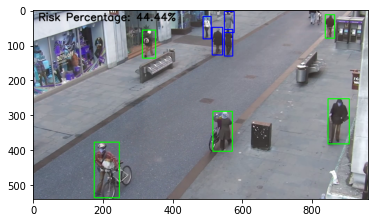

** Frame # 114 **

Person # 0, located: (850, 46) confidence: 89.25
Person # 1, located: (562, 33) confidence: 92.87
Person # 2, located: (498, 50) confidence: 96.83
Person # 3, located: (208, 458) confidence: 96.96
Person # 4, located: (543, 344) confidence: 97.06
Person # 5, located: (528, 88) confidence: 97.66
Person # 6, located: (874, 320) confidence: 97.96
Person # 7, located: (560, 92) confidence: 98.63

Total number of people 8
Total number of people who break social distancing measure 4
People ids who break social distancing measure [1, 7, 2, 5]



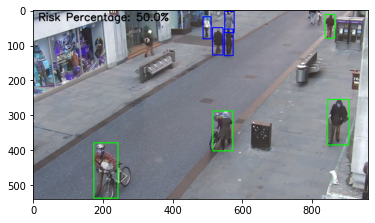

** Frame # 115 **

Person # 0, located: (851, 45) confidence: 91.55
Person # 1, located: (562, 32) confidence: 93.78
Person # 2, located: (529, 88) confidence: 94.91
Person # 3, located: (544, 343) confidence: 95.5
Person # 4, located: (497, 51) confidence: 96.1
Person # 5, located: (206, 460) confidence: 96.76
Person # 6, located: (561, 91) confidence: 97.15
Person # 7, located: (873, 321) confidence: 97.46

Total number of people 8
Total number of people who break social distancing measure 4
People ids who break social distancing measure [1, 6, 2, 4]



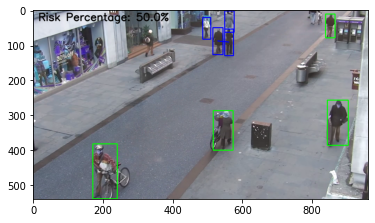

** Frame # 116 **

Person # 0, located: (199, 461) confidence: 82.9
Person # 1, located: (562, 32) confidence: 89.73
Person # 2, located: (851, 44) confidence: 90.41
Person # 3, located: (531, 88) confidence: 95.32
Person # 4, located: (496, 52) confidence: 95.99
Person # 5, located: (563, 91) confidence: 96.48
Person # 6, located: (872, 322) confidence: 96.59
Person # 7, located: (546, 338) confidence: 97.25

Total number of people 8
Total number of people who break social distancing measure 4
People ids who break social distancing measure [1, 5, 3, 4]



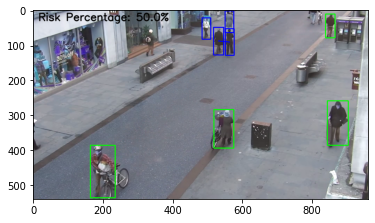

** Frame # 117 **

Person # 0, located: (803, 19) confidence: 53.19
Person # 1, located: (337, 92) confidence: 67.1
Person # 2, located: (197, 461) confidence: 89.27
Person # 3, located: (562, 33) confidence: 90.21
Person # 4, located: (851, 44) confidence: 90.24
Person # 5, located: (565, 90) confidence: 95.57
Person # 6, located: (495, 52) confidence: 95.97
Person # 7, located: (872, 324) confidence: 96.44
Person # 8, located: (532, 87) confidence: 96.57
Person # 9, located: (547, 334) confidence: 98.22

Total number of people 10
Total number of people who break social distancing measure 6
People ids who break social distancing measure [0, 4, 3, 5, 8, 6]



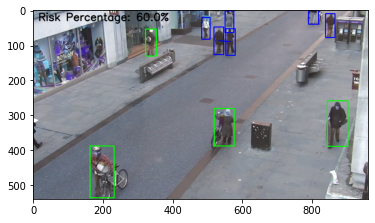

** Frame # 118 **

Person # 0, located: (14, 345) confidence: 63.62
Person # 1, located: (339, 91) confidence: 75.09
Person # 2, located: (563, 32) confidence: 87.87
Person # 3, located: (852, 43) confidence: 87.95
Person # 4, located: (195, 463) confidence: 93.51
Person # 5, located: (533, 86) confidence: 95.51
Person # 6, located: (566, 90) confidence: 95.75
Person # 7, located: (494, 52) confidence: 95.78
Person # 8, located: (870, 324) confidence: 96.56
Person # 9, located: (548, 333) confidence: 98.49

Total number of people 10
Total number of people who break social distancing measure 4
People ids who break social distancing measure [2, 6, 5, 7]



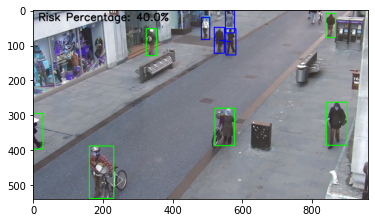

** Frame # 119 **

Person # 0, located: (15, 346) confidence: 80.72
Person # 1, located: (852, 43) confidence: 80.83
Person # 2, located: (339, 91) confidence: 86.27
Person # 3, located: (564, 33) confidence: 90.2
Person # 4, located: (534, 84) confidence: 93.54
Person # 5, located: (493, 53) confidence: 95.72
Person # 6, located: (191, 464) confidence: 95.92
Person # 7, located: (566, 90) confidence: 96.5
Person # 8, located: (869, 322) confidence: 97.42
Person # 9, located: (550, 332) confidence: 98.55

Total number of people 10
Total number of people who break social distancing measure 4
People ids who break social distancing measure [3, 4, 7, 5]



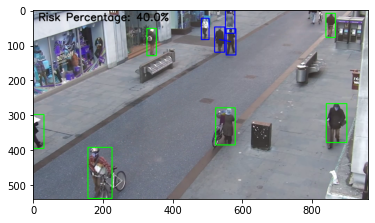

** Frame # 120 **

Person # 0, located: (340, 90) confidence: 62.0
Person # 1, located: (565, 33) confidence: 82.91
Person # 2, located: (853, 43) confidence: 83.2
Person # 3, located: (15, 347) confidence: 89.82
Person # 4, located: (492, 53) confidence: 94.42
Person # 5, located: (567, 89) confidence: 95.81
Person # 6, located: (186, 465) confidence: 96.12
Person # 7, located: (535, 83) confidence: 96.13
Person # 8, located: (552, 331) confidence: 96.98
Person # 9, located: (868, 322) confidence: 97.34

Total number of people 10
Total number of people who break social distancing measure 4
People ids who break social distancing measure [1, 5, 7, 4]



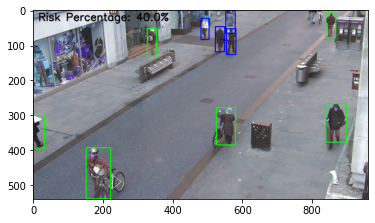

** Frame # 121 **

Person # 0, located: (14, 346) confidence: 72.44
Person # 1, located: (342, 90) confidence: 80.78
Person # 2, located: (853, 43) confidence: 81.53
Person # 3, located: (566, 33) confidence: 84.76
Person # 4, located: (491, 53) confidence: 93.77
Person # 5, located: (536, 82) confidence: 95.72
Person # 6, located: (182, 467) confidence: 96.1
Person # 7, located: (569, 88) confidence: 96.46
Person # 8, located: (553, 330) confidence: 97.35
Person # 9, located: (866, 327) confidence: 97.79

Total number of people 10
Total number of people who break social distancing measure 4
People ids who break social distancing measure [3, 5, 7, 4]



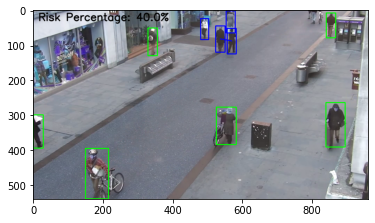

** Frame # 122 **

Person # 0, located: (853, 43) confidence: 77.67
Person # 1, located: (566, 35) confidence: 84.12
Person # 2, located: (343, 90) confidence: 89.97
Person # 3, located: (14, 336) confidence: 92.43
Person # 4, located: (490, 54) confidence: 92.69
Person # 5, located: (181, 470) confidence: 95.42
Person # 6, located: (537, 82) confidence: 95.8
Person # 7, located: (554, 329) confidence: 96.02
Person # 8, located: (570, 88) confidence: 96.59
Person # 9, located: (865, 329) confidence: 98.62

Total number of people 10
Total number of people who break social distancing measure 4
People ids who break social distancing measure [1, 6, 8, 4]



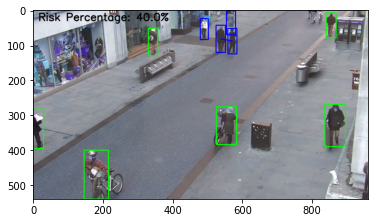

** Frame # 123 **

Person # 0, located: (802, 19) confidence: 50.15
Person # 1, located: (854, 41) confidence: 80.93
Person # 2, located: (566, 36) confidence: 84.65
Person # 3, located: (344, 91) confidence: 87.18
Person # 4, located: (15, 333) confidence: 90.83
Person # 5, located: (488, 54) confidence: 93.53
Person # 6, located: (179, 472) confidence: 95.11
Person # 7, located: (539, 81) confidence: 95.85
Person # 8, located: (556, 329) confidence: 96.1
Person # 9, located: (572, 87) confidence: 96.68
Person # 10, located: (864, 332) confidence: 99.22

Total number of people 11
Total number of people who break social distancing measure 6
People ids who break social distancing measure [0, 1, 2, 7, 9, 5]



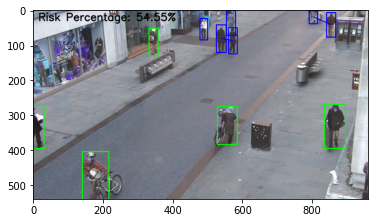

** Frame # 124 **

Person # 0, located: (805, 19) confidence: 53.93
Person # 1, located: (854, 41) confidence: 79.86
Person # 2, located: (346, 91) confidence: 83.25
Person # 3, located: (568, 36) confidence: 85.42
Person # 4, located: (487, 55) confidence: 91.15
Person # 5, located: (15, 334) confidence: 93.42
Person # 6, located: (573, 86) confidence: 94.3
Person # 7, located: (540, 81) confidence: 94.92
Person # 8, located: (557, 329) confidence: 97.08
Person # 9, located: (177, 474) confidence: 97.46
Person # 10, located: (864, 334) confidence: 99.17

Total number of people 11
Total number of people who break social distancing measure 6
People ids who break social distancing measure [0, 1, 3, 6, 7, 4]



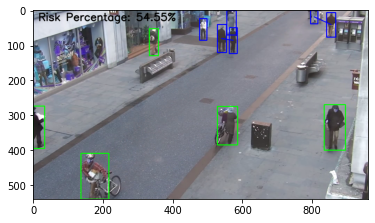

** Frame # 125 **

Person # 0, located: (805, 19) confidence: 65.21
Person # 1, located: (854, 41) confidence: 75.8
Person # 2, located: (569, 34) confidence: 81.99
Person # 3, located: (346, 91) confidence: 84.03
Person # 4, located: (486, 55) confidence: 90.28
Person # 5, located: (575, 87) confidence: 92.03
Person # 6, located: (17, 333) confidence: 94.89
Person # 7, located: (174, 476) confidence: 95.6
Person # 8, located: (542, 81) confidence: 95.94
Person # 9, located: (557, 328) confidence: 97.33
Person # 10, located: (863, 337) confidence: 98.74

Total number of people 11
Total number of people who break social distancing measure 5
People ids who break social distancing measure [0, 1, 2, 5, 8]



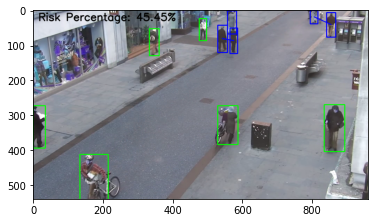

** Frame # 126 **

Person # 0, located: (825, 18) confidence: 51.53
Person # 1, located: (804, 19) confidence: 55.22
Person # 2, located: (347, 91) confidence: 75.2
Person # 3, located: (854, 41) confidence: 79.91
Person # 4, located: (571, 32) confidence: 83.16
Person # 5, located: (485, 55) confidence: 85.94
Person # 6, located: (576, 86) confidence: 91.85
Person # 7, located: (18, 331) confidence: 95.49
Person # 8, located: (171, 477) confidence: 96.29
Person # 9, located: (543, 81) confidence: 96.92
Person # 10, located: (862, 342) confidence: 97.08
Person # 11, located: (558, 325) confidence: 97.2

Total number of people 12
Total number of people who break social distancing measure 6
People ids who break social distancing measure [0, 1, 3, 4, 6, 9]



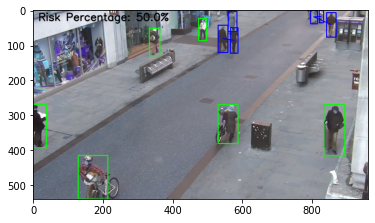

** Frame # 127 **

Person # 0, located: (825, 18) confidence: 50.6
Person # 1, located: (349, 89) confidence: 84.64
Person # 2, located: (854, 41) confidence: 86.78
Person # 3, located: (484, 57) confidence: 87.62
Person # 4, located: (571, 31) confidence: 89.4
Person # 5, located: (577, 86) confidence: 90.51
Person # 6, located: (20, 331) confidence: 95.5
Person # 7, located: (544, 81) confidence: 97.76
Person # 8, located: (559, 323) confidence: 97.77
Person # 9, located: (170, 479) confidence: 98.11
Person # 10, located: (862, 345) confidence: 98.73

Total number of people 11
Total number of people who break social distancing measure 5
People ids who break social distancing measure [0, 2, 4, 5, 7]



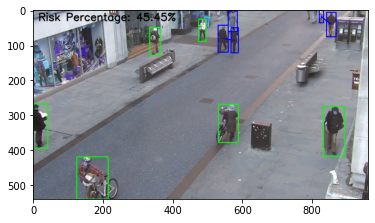

** Frame # 128 **

Person # 0, located: (804, 19) confidence: 55.04
Person # 1, located: (825, 17) confidence: 56.67
Person # 2, located: (572, 31) confidence: 85.62
Person # 3, located: (350, 88) confidence: 87.14
Person # 4, located: (854, 40) confidence: 90.16
Person # 5, located: (483, 58) confidence: 91.0
Person # 6, located: (577, 84) confidence: 92.03
Person # 7, located: (166, 480) confidence: 95.63
Person # 8, located: (22, 330) confidence: 96.62
Person # 9, located: (560, 320) confidence: 97.02
Person # 10, located: (544, 81) confidence: 97.5
Person # 11, located: (861, 347) confidence: 98.66

Total number of people 12
Total number of people who break social distancing measure 6
People ids who break social distancing measure [0, 1, 4, 2, 6, 10]



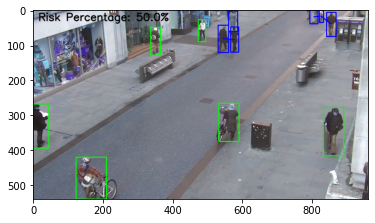

** Frame # 129 **

Person # 0, located: (826, 17) confidence: 55.31
Person # 1, located: (805, 18) confidence: 60.28
Person # 2, located: (574, 31) confidence: 84.77
Person # 3, located: (352, 87) confidence: 89.07
Person # 4, located: (854, 38) confidence: 91.2
Person # 5, located: (578, 83) confidence: 91.38
Person # 6, located: (23, 330) confidence: 92.44
Person # 7, located: (482, 59) confidence: 93.89
Person # 8, located: (545, 80) confidence: 96.38
Person # 9, located: (562, 318) confidence: 96.55
Person # 10, located: (160, 479) confidence: 96.71
Person # 11, located: (860, 349) confidence: 98.44

Total number of people 12
Total number of people who break social distancing measure 6
People ids who break social distancing measure [0, 1, 4, 2, 5, 8]



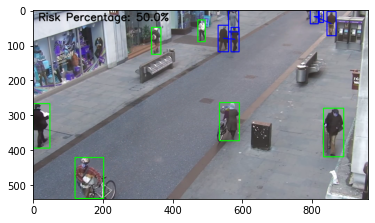

** Frame # 130 **

Person # 0, located: (826, 18) confidence: 56.27
Person # 1, located: (805, 18) confidence: 60.39
Person # 2, located: (575, 30) confidence: 81.22
Person # 3, located: (354, 86) confidence: 83.62
Person # 4, located: (854, 37) confidence: 91.37
Person # 5, located: (579, 83) confidence: 92.09
Person # 6, located: (482, 59) confidence: 95.4
Person # 7, located: (564, 316) confidence: 95.57
Person # 8, located: (26, 330) confidence: 96.05
Person # 9, located: (156, 479) confidence: 96.33
Person # 10, located: (545, 79) confidence: 96.9
Person # 11, located: (860, 351) confidence: 98.65

Total number of people 12
Total number of people who break social distancing measure 6
People ids who break social distancing measure [0, 1, 4, 2, 5, 10]



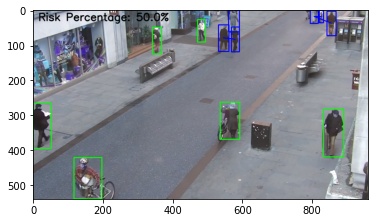

** Frame # 131 **

Person # 0, located: (826, 18) confidence: 59.29
Person # 1, located: (805, 18) confidence: 66.03
Person # 2, located: (354, 84) confidence: 82.93
Person # 3, located: (576, 30) confidence: 87.65
Person # 4, located: (155, 481) confidence: 91.01
Person # 5, located: (854, 37) confidence: 91.25
Person # 6, located: (580, 83) confidence: 92.88
Person # 7, located: (481, 59) confidence: 95.81
Person # 8, located: (564, 315) confidence: 95.95
Person # 9, located: (26, 329) confidence: 96.7
Person # 10, located: (860, 353) confidence: 97.42
Person # 11, located: (547, 78) confidence: 97.68

Total number of people 12
Total number of people who break social distancing measure 6
People ids who break social distancing measure [0, 1, 5, 3, 6, 11]



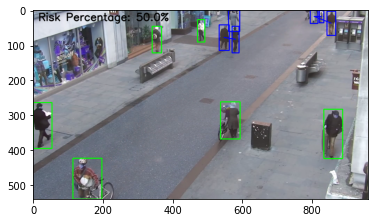

** Frame # 132 **

Person # 0, located: (827, 18) confidence: 56.33
Person # 1, located: (805, 18) confidence: 66.38
Person # 2, located: (576, 26) confidence: 79.88
Person # 3, located: (355, 83) confidence: 89.18
Person # 4, located: (580, 82) confidence: 90.7
Person # 5, located: (147, 481) confidence: 90.98
Person # 6, located: (855, 37) confidence: 92.36
Person # 7, located: (859, 354) confidence: 92.87
Person # 8, located: (480, 59) confidence: 93.08
Person # 9, located: (564, 314) confidence: 94.38
Person # 10, located: (29, 328) confidence: 96.55
Person # 11, located: (548, 77) confidence: 97.79

Total number of people 12
Total number of people who break social distancing measure 6
People ids who break social distancing measure [0, 1, 6, 2, 4, 11]



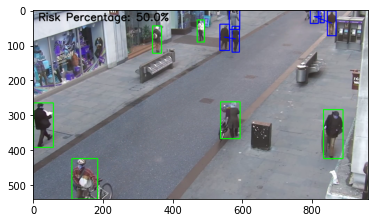

** Frame # 133 **

Person # 0, located: (806, 18) confidence: 56.82
Person # 1, located: (828, 17) confidence: 58.78
Person # 2, located: (577, 26) confidence: 82.01
Person # 3, located: (855, 37) confidence: 91.75
Person # 4, located: (144, 482) confidence: 92.66
Person # 5, located: (355, 82) confidence: 92.66
Person # 6, located: (581, 82) confidence: 94.79
Person # 7, located: (860, 354) confidence: 94.93
Person # 8, located: (566, 310) confidence: 95.24
Person # 9, located: (478, 59) confidence: 96.08
Person # 10, located: (31, 326) confidence: 96.77
Person # 11, located: (549, 76) confidence: 98.36

Total number of people 12
Total number of people who break social distancing measure 6
People ids who break social distancing measure [0, 1, 3, 2, 6, 11]



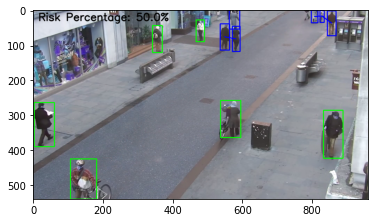

** Frame # 134 **

Person # 0, located: (806, 16) confidence: 57.64
Person # 1, located: (827, 17) confidence: 63.64
Person # 2, located: (577, 25) confidence: 82.96
Person # 3, located: (356, 82) confidence: 90.08
Person # 4, located: (140, 484) confidence: 91.17
Person # 5, located: (855, 37) confidence: 92.59
Person # 6, located: (567, 310) confidence: 95.35
Person # 7, located: (582, 81) confidence: 95.38
Person # 8, located: (860, 355) confidence: 95.68
Person # 9, located: (478, 59) confidence: 96.55
Person # 10, located: (33, 324) confidence: 97.6
Person # 11, located: (550, 75) confidence: 98.6

Total number of people 12
Total number of people who break social distancing measure 6
People ids who break social distancing measure [0, 1, 5, 2, 7, 11]



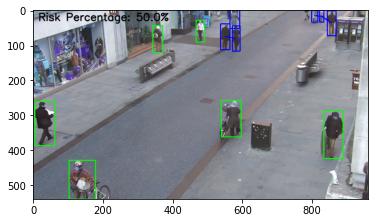

** Frame # 135 **

Person # 0, located: (560, 12) confidence: 56.77
Person # 1, located: (359, 81) confidence: 80.96
Person # 2, located: (578, 25) confidence: 81.57
Person # 3, located: (856, 37) confidence: 90.55
Person # 4, located: (569, 309) confidence: 95.93
Person # 5, located: (860, 358) confidence: 96.0
Person # 6, located: (478, 60) confidence: 96.09
Person # 7, located: (583, 80) confidence: 96.49
Person # 8, located: (138, 486) confidence: 96.5
Person # 9, located: (35, 320) confidence: 97.94
Person # 10, located: (551, 76) confidence: 98.49

Total number of people 11
Total number of people who break social distancing measure 4
People ids who break social distancing measure [0, 2, 7, 10]



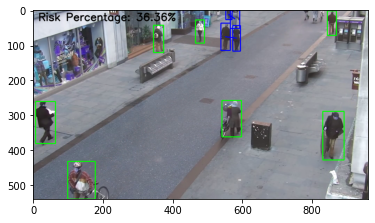

** Frame # 136 **

Person # 0, located: (560, 12) confidence: 58.05
Person # 1, located: (578, 25) confidence: 72.95
Person # 2, located: (362, 82) confidence: 81.4
Person # 3, located: (856, 37) confidence: 92.36
Person # 4, located: (37, 316) confidence: 96.66
Person # 5, located: (583, 80) confidence: 96.72
Person # 6, located: (133, 489) confidence: 96.81
Person # 7, located: (478, 61) confidence: 96.92
Person # 8, located: (860, 360) confidence: 96.93
Person # 9, located: (569, 310) confidence: 96.98
Person # 10, located: (552, 76) confidence: 98.08

Total number of people 11
Total number of people who break social distancing measure 4
People ids who break social distancing measure [0, 1, 5, 10]



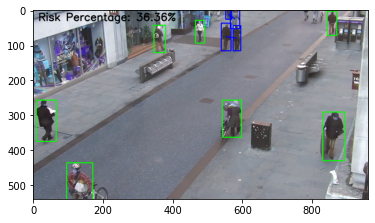

** Frame # 137 **

Person # 0, located: (560, 12) confidence: 58.95
Person # 1, located: (578, 26) confidence: 71.66
Person # 2, located: (363, 82) confidence: 82.54
Person # 3, located: (856, 37) confidence: 90.21
Person # 4, located: (130, 490) confidence: 93.63
Person # 5, located: (40, 314) confidence: 94.89
Person # 6, located: (477, 62) confidence: 96.18
Person # 7, located: (584, 79) confidence: 96.55
Person # 8, located: (571, 309) confidence: 96.95
Person # 9, located: (553, 75) confidence: 97.68
Person # 10, located: (860, 361) confidence: 97.95

Total number of people 11
Total number of people who break social distancing measure 4
People ids who break social distancing measure [0, 1, 7, 9]



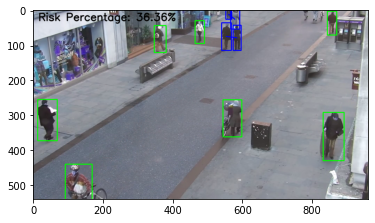

** Frame # 138 **

Person # 0, located: (780, 15) confidence: 59.11
Person # 1, located: (364, 82) confidence: 70.13
Person # 2, located: (579, 26) confidence: 74.3
Person # 3, located: (857, 36) confidence: 90.26
Person # 4, located: (126, 492) confidence: 95.12
Person # 5, located: (43, 311) confidence: 95.72
Person # 6, located: (585, 78) confidence: 96.03
Person # 7, located: (554, 75) confidence: 96.45
Person # 8, located: (477, 62) confidence: 96.98
Person # 9, located: (860, 361) confidence: 97.83
Person # 10, located: (572, 307) confidence: 98.11

Total number of people 11
Total number of people who break social distancing measure 3
People ids who break social distancing measure [2, 6, 7]



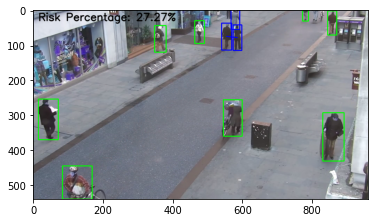

** Frame # 139 **

Person # 0, located: (561, 12) confidence: 59.18
Person # 1, located: (366, 82) confidence: 66.67
Person # 2, located: (779, 15) confidence: 69.83
Person # 3, located: (579, 25) confidence: 76.08
Person # 4, located: (857, 36) confidence: 87.55
Person # 5, located: (125, 494) confidence: 91.66
Person # 6, located: (555, 74) confidence: 93.01
Person # 7, located: (45, 311) confidence: 93.81
Person # 8, located: (586, 78) confidence: 96.06
Person # 9, located: (476, 63) confidence: 96.76
Person # 10, located: (857, 363) confidence: 97.04
Person # 11, located: (574, 305) confidence: 97.98

Total number of people 12
Total number of people who break social distancing measure 4
People ids who break social distancing measure [0, 3, 6, 8]



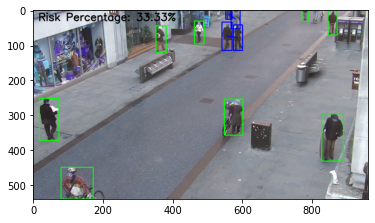

** Frame # 140 **

Person # 0, located: (778, 15) confidence: 66.13
Person # 1, located: (561, 12) confidence: 72.48
Person # 2, located: (366, 82) confidence: 74.04
Person # 3, located: (580, 26) confidence: 75.41
Person # 4, located: (857, 35) confidence: 85.81
Person # 5, located: (48, 311) confidence: 93.38
Person # 6, located: (118, 494) confidence: 95.18
Person # 7, located: (556, 74) confidence: 95.31
Person # 8, located: (587, 78) confidence: 96.14
Person # 9, located: (857, 366) confidence: 97.22
Person # 10, located: (476, 63) confidence: 97.79
Person # 11, located: (575, 304) confidence: 97.82

Total number of people 12
Total number of people who break social distancing measure 4
People ids who break social distancing measure [1, 3, 7, 8]



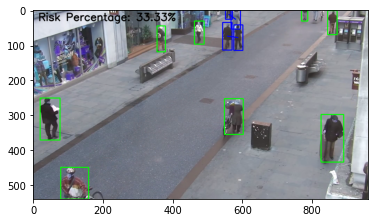

** Frame # 141 **

Person # 0, located: (777, 15) confidence: 70.28
Person # 1, located: (560, 12) confidence: 74.1
Person # 2, located: (366, 81) confidence: 78.57
Person # 3, located: (581, 26) confidence: 81.09
Person # 4, located: (857, 34) confidence: 81.13
Person # 5, located: (52, 310) confidence: 93.56
Person # 6, located: (120, 496) confidence: 93.62
Person # 7, located: (588, 78) confidence: 95.66
Person # 8, located: (857, 367) confidence: 96.2
Person # 9, located: (577, 302) confidence: 96.31
Person # 10, located: (557, 74) confidence: 96.61
Person # 11, located: (474, 64) confidence: 97.1

Total number of people 12
Total number of people who break social distancing measure 4
People ids who break social distancing measure [1, 3, 7, 10]



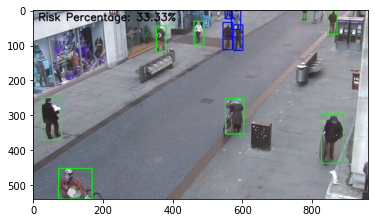

** Frame # 142 **

Person # 0, located: (776, 16) confidence: 72.22
Person # 1, located: (559, 12) confidence: 73.48
Person # 2, located: (860, 33) confidence: 80.66
Person # 3, located: (582, 26) confidence: 86.16
Person # 4, located: (368, 80) confidence: 91.55
Person # 5, located: (58, 309) confidence: 93.49
Person # 6, located: (577, 301) confidence: 94.25
Person # 7, located: (113, 497) confidence: 94.32
Person # 8, located: (589, 77) confidence: 95.61
Person # 9, located: (857, 373) confidence: 96.77
Person # 10, located: (558, 73) confidence: 97.02
Person # 11, located: (473, 63) confidence: 97.51

Total number of people 12
Total number of people who break social distancing measure 4
People ids who break social distancing measure [1, 3, 8, 10]



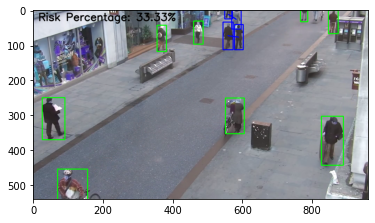

** Frame # 143 **

Person # 0, located: (560, 12) confidence: 69.63
Person # 1, located: (775, 16) confidence: 73.87
Person # 2, located: (860, 33) confidence: 83.48
Person # 3, located: (582, 26) confidence: 85.71
Person # 4, located: (369, 79) confidence: 89.97
Person # 5, located: (63, 310) confidence: 93.68
Person # 6, located: (107, 498) confidence: 94.35
Person # 7, located: (590, 76) confidence: 94.9
Person # 8, located: (578, 299) confidence: 95.25
Person # 9, located: (559, 73) confidence: 95.36
Person # 10, located: (472, 64) confidence: 96.64
Person # 11, located: (856, 375) confidence: 98.62

Total number of people 12
Total number of people who break social distancing measure 4
People ids who break social distancing measure [0, 3, 7, 9]



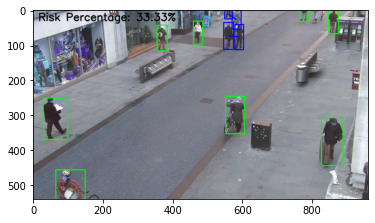

** Frame # 144 **

Person # 0, located: (559, 12) confidence: 67.0
Person # 1, located: (774, 16) confidence: 74.12
Person # 2, located: (583, 26) confidence: 74.32
Person # 3, located: (860, 32) confidence: 84.49
Person # 4, located: (561, 71) confidence: 89.87
Person # 5, located: (66, 309) confidence: 92.26
Person # 6, located: (370, 79) confidence: 94.14
Person # 7, located: (104, 499) confidence: 94.61
Person # 8, located: (592, 75) confidence: 96.09
Person # 9, located: (470, 63) confidence: 96.75
Person # 10, located: (579, 298) confidence: 97.18
Person # 11, located: (856, 377) confidence: 97.88

Total number of people 12
Total number of people who break social distancing measure 4
People ids who break social distancing measure [0, 2, 4, 8]



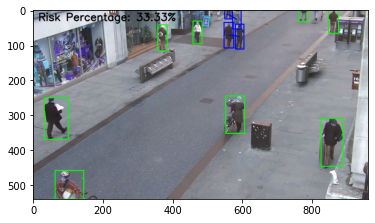

** Frame # 145 **

Person # 0, located: (559, 12) confidence: 64.9
Person # 1, located: (584, 26) confidence: 69.02
Person # 2, located: (774, 16) confidence: 81.34
Person # 3, located: (98, 501) confidence: 84.95
Person # 4, located: (861, 32) confidence: 86.59
Person # 5, located: (561, 69) confidence: 89.66
Person # 6, located: (371, 77) confidence: 92.54
Person # 7, located: (68, 309) confidence: 94.36
Person # 8, located: (469, 64) confidence: 96.41
Person # 9, located: (579, 298) confidence: 96.57
Person # 10, located: (593, 75) confidence: 96.64
Person # 11, located: (855, 377) confidence: 97.91

Total number of people 12
Total number of people who break social distancing measure 4
People ids who break social distancing measure [0, 1, 5, 10]



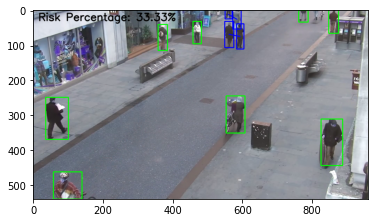

** Frame # 146 **

Person # 0, located: (559, 12) confidence: 62.31
Person # 1, located: (584, 26) confidence: 69.04
Person # 2, located: (372, 77) confidence: 81.08
Person # 3, located: (774, 17) confidence: 85.64
Person # 4, located: (95, 502) confidence: 88.42
Person # 5, located: (861, 32) confidence: 89.37
Person # 6, located: (562, 69) confidence: 92.69
Person # 7, located: (70, 307) confidence: 93.55
Person # 8, located: (468, 64) confidence: 95.12
Person # 9, located: (594, 74) confidence: 96.99
Person # 10, located: (855, 379) confidence: 97.6
Person # 11, located: (581, 298) confidence: 98.06

Total number of people 12
Total number of people who break social distancing measure 4
People ids who break social distancing measure [0, 1, 6, 9]



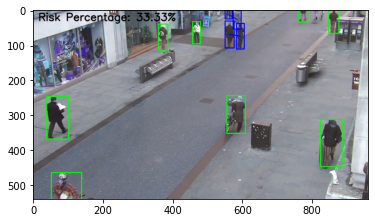

** Frame # 147 **

Person # 0, located: (373, 76) confidence: 55.22
Person # 1, located: (559, 12) confidence: 61.05
Person # 2, located: (584, 26) confidence: 69.75
Person # 3, located: (773, 16) confidence: 88.36
Person # 4, located: (861, 32) confidence: 90.27
Person # 5, located: (94, 504) confidence: 92.41
Person # 6, located: (467, 65) confidence: 94.25
Person # 7, located: (563, 68) confidence: 94.75
Person # 8, located: (854, 379) confidence: 96.46
Person # 9, located: (71, 306) confidence: 96.59
Person # 10, located: (595, 74) confidence: 96.81
Person # 11, located: (582, 297) confidence: 97.83

Total number of people 12
Total number of people who break social distancing measure 4
People ids who break social distancing measure [1, 2, 7, 10]



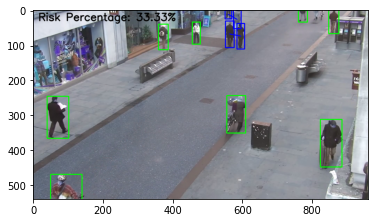

** Frame # 148 **

Person # 0, located: (558, 12) confidence: 58.4
Person # 1, located: (585, 25) confidence: 65.75
Person # 2, located: (373, 77) confidence: 77.64
Person # 3, located: (772, 16) confidence: 86.36
Person # 4, located: (861, 32) confidence: 90.26
Person # 5, located: (87, 507) confidence: 92.71
Person # 6, located: (564, 68) confidence: 93.96
Person # 7, located: (466, 66) confidence: 95.37
Person # 8, located: (595, 74) confidence: 95.92
Person # 9, located: (73, 303) confidence: 96.67
Person # 10, located: (854, 380) confidence: 96.89
Person # 11, located: (582, 294) confidence: 97.7

Total number of people 12
Total number of people who break social distancing measure 4
People ids who break social distancing measure [0, 1, 6, 8]



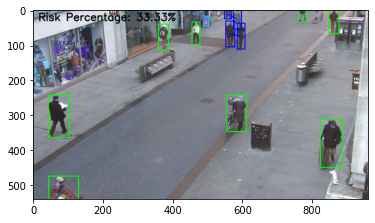

** Frame # 149 **

Person # 0, located: (558, 11) confidence: 61.79
Person # 1, located: (586, 26) confidence: 63.04
Person # 2, located: (771, 16) confidence: 79.83
Person # 3, located: (375, 76) confidence: 80.36
Person # 4, located: (84, 509) confidence: 87.4
Person # 5, located: (861, 31) confidence: 87.86
Person # 6, located: (565, 67) confidence: 94.68
Person # 7, located: (465, 67) confidence: 95.12
Person # 8, located: (75, 299) confidence: 95.5
Person # 9, located: (596, 74) confidence: 96.14
Person # 10, located: (583, 291) confidence: 96.79
Person # 11, located: (853, 381) confidence: 97.64

Total number of people 12
Total number of people who break social distancing measure 4
People ids who break social distancing measure [0, 1, 6, 9]



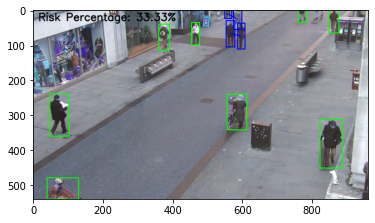

** Frame # 150 **

Person # 0, located: (558, 11) confidence: 60.58
Person # 1, located: (586, 26) confidence: 68.8
Person # 2, located: (81, 510) confidence: 70.43
Person # 3, located: (770, 17) confidence: 78.36
Person # 4, located: (376, 76) confidence: 85.74
Person # 5, located: (861, 31) confidence: 85.86
Person # 6, located: (567, 67) confidence: 94.77
Person # 7, located: (597, 74) confidence: 95.88
Person # 8, located: (585, 289) confidence: 95.91
Person # 9, located: (465, 68) confidence: 96.15
Person # 10, located: (76, 297) confidence: 96.23
Person # 11, located: (853, 384) confidence: 97.29

Total number of people 12
Total number of people who break social distancing measure 4
People ids who break social distancing measure [0, 1, 6, 7]



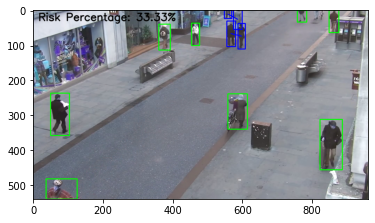

** Frame # 151 **

Person # 0, located: (558, 11) confidence: 50.11
Person # 1, located: (587, 25) confidence: 62.82
Person # 2, located: (77, 513) confidence: 73.24
Person # 3, located: (377, 76) confidence: 76.07
Person # 4, located: (769, 17) confidence: 80.9
Person # 5, located: (862, 31) confidence: 83.69
Person # 6, located: (587, 287) confidence: 93.85
Person # 7, located: (464, 68) confidence: 95.08
Person # 8, located: (568, 67) confidence: 95.15
Person # 9, located: (597, 74) confidence: 95.21
Person # 10, located: (79, 295) confidence: 97.05
Person # 11, located: (852, 385) confidence: 98.45

Total number of people 12
Total number of people who break social distancing measure 4
People ids who break social distancing measure [0, 1, 8, 9]



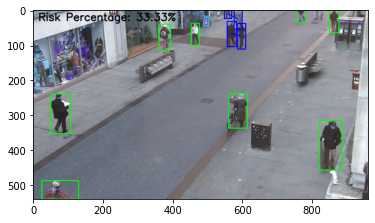

** End of Detection **
** The percentage risk for this video is about 42.64%
Please look at the output of the system in the file located in Simulation_project/data/Output **


In [53]:
file_input = '/content/Simulation_project/data/Input/OxfordTownCenter.mp4'
YOLO(file_input)